# Train All Single Models
1. Linear Regression
   - Elastic Net
   - Ridge
   - Lasso
2. Boosting Decision Trees
   - GBR
   - LightGBM
   - XGBoostRegressor (the optimization version of GBDT by using L1/L2 regularization.)
3. RandomForest
   - RandomForest(RF)
   - ExtremeRandomTrees(ERT)
4. Kernel Ridge Regression(KRR)
5. K-Nearest Neighbor(KNN)
6. Support Vector Regressor(SVR)

In [1]:
# import libraries
import os
import sys
import numpy as np
import pandas as pd
# Set random seed for reproducibility
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)

In [2]:
current_path = os.getcwd()
current_path

'/output/workspace/Band-gap-predict/SingleModels'

In [3]:
# To import the custom module from a specific path
sys.path.insert(0, os.path.join(current_path, '../'))
# Importing the custom module
from Utools.draw import plot_feature_importance, plot_feature_importance
from Utools.SingleModel import SingleModel

In [4]:
from sklearn.base import clone
# Import sklearn models
from lightgbm import LGBMRegressor
from xgboost import XGBRegressor
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor, ExtraTreesRegressor
from sklearn.kernel_approximation import Nystroem
from sklearn.linear_model import ElasticNet, Ridge, Lasso
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.pipeline import Pipeline

## Load Data

In [5]:
# Load data
file_dir = os.path.join(current_path, '../Data/composition_data/feature_data')
# dft data
dft_train = pd.read_csv(os.path.join(file_dir, 'dft', 'train.csv'))
dft_test = pd.read_csv(os.path.join(file_dir, 'dft', 'test.csv'))
# exp data
exp_train = pd.read_csv(os.path.join(file_dir, 'exp', 'train.csv'))
exp_test = pd.read_csv(os.path.join(file_dir, 'exp', 'test.csv'))

In [6]:
dft_train_X = dft_train.drop(columns=['composition', 'band_gap'])
dft_train_y = dft_train['band_gap']
exp_train_X = exp_train.drop(columns=['composition', 'band_gap'])
exp_train_y = exp_train['band_gap']
dft_test_X = dft_test.drop(columns=['composition', 'band_gap'])
dft_test_y = dft_test['band_gap']
exp_test_X = exp_test.drop(columns=['composition', 'band_gap'])
exp_test_y = exp_test['band_gap']

In [7]:
# save model performance as df
metrics_df = pd.DataFrame(columns=['Model', 'Train_set', 'Test_set', 'R²', 'RMSE', 'MAE'])

## Model Train

In [ ]:
# define dft_models with the best hyper parameters in the pervious step
dft_models = {
    # Linear models
    'ElasticNet': ElasticNet(alpha=0.01, l1_ratio=0.05, random_state=RANDOM_SEED),
    'Ridge': Ridge(alpha=1.0, random_state=RANDOM_SEED),
    'Lasso': Lasso(alpha=0.05, random_state=RANDOM_SEED), 
    # GBDT models
    'GBR': GradientBoostingRegressor(
    n_estimators=500, learning_rate=0.05, max_depth=10, 
    max_features=0.25, subsample=1.0, random_state=RANDOM_SEED),

    'LightGBM': LGBMRegressor(learning_rate=0.2, max_depth=-1, n_estimators=500,
    objective='regression', random_state=RANDOM_SEED, n_jobs=-1),

    'XGBoost': XGBRegressor(learning_rate=0.05, max_depth=10, n_estimators=500,
    colsample_bytree=0.7, subsample=1.0, reg_lambda=1.0, alpha=0.5, 
    objective='reg:squarederror', random_state=RANDOM_SEED, n_jobs=-1),

    # Random Forest models
    'RandomForest': RandomForestRegressor(
    n_estimators=500, max_depth=None, min_samples_split=2, min_samples_leaf=1,
    max_features=0.5, random_state=RANDOM_SEED, n_jobs=-1),
    
    'ExtraRandomTrees': ExtraTreesRegressor(
    n_estimators=500, max_depth=None, min_samples_split=7, min_samples_leaf=1,
    max_features=0.5, random_state=RANDOM_SEED, n_jobs=-1),
    
    'KNN': KNeighborsRegressor(n_neighbors=11, weights='distance', metric='minkowski', p=1, n_jobs=-1),
    # the two last models are too slow
    'KernelRidge': Pipeline([
    ('nystroem', Nystroem(kernel='rbf',  n_components=8000, random_state=RANDOM_SEED)),
    ('ridge', Ridge(alpha=1.0))]),
    # SVM models
    # SVR's training time is too long, so we use Ya Zhuo et's hyper parameter
    'SVR': SVR(kernel='rbf', C=25, epsilon=0.07, gamma=0.01)    # about 41min to train
}

In [ ]:
# define exp_models with the best hyper parameters in the pervious step
exp_models = {
    'ElasticNet': ElasticNet(alpha=0.1, l1_ratio=0.7, max_iter=10000, random_state=RANDOM_SEED),
    # Linear models
    'Ridge': Ridge(alpha=1.0, random_state=RANDOM_SEED),
    'Lasso': Lasso(alpha=0.1, random_state=RANDOM_SEED), 
    # GBDT models
    'GBR': GradientBoostingRegressor(
    n_estimators=500, learning_rate=0.05, max_depth=5,
    max_features=1.0, subsample=0.75, random_state=RANDOM_SEED),

    'LightGBM': LGBMRegressor(learning_rate=0.05, max_depth=-1, n_estimators=500,
    objective='regression', random_state=RANDOM_SEED, n_jobs=-1),
    
    'XGBoost': XGBRegressor(learning_rate=0.1, max_depth=5, n_estimators=500,
    colsample_bytree=0.7, subsample=0.7, reg_lambda=1.0, alpha=0,
    objective='reg:squarederror', random_state=RANDOM_SEED, n_jobs=-1),

    # Random Forest models
    'RandomForest': RandomForestRegressor(
    n_estimators=500, max_depth=None, min_samples_split=2, min_samples_leaf=1,
    max_features='sqrt', random_state=RANDOM_SEED, n_jobs=-1),
    
    'ExtraRandomTrees': ExtraTreesRegressor(
    n_estimators=300, max_depth=None, min_samples_split=2, min_samples_leaf=1,
    max_features=0.5, random_state=RANDOM_SEED, n_jobs=-1),

    'KNN': KNeighborsRegressor(n_neighbors=3, weights='uniform', p=1, metric='manhattan', n_jobs=-1),
    # the two last models are too slow
    'KernelRidge': Pipeline([
    ('nystroem', Nystroem(kernel='rbf',  n_components=1800, random_state=RANDOM_SEED)),
    ('ridge', Ridge(alpha=0.05))]),
    # SVM models
    # SVR's training time is too long, so we use Ya Zhuo et's hyper parameter
    'SVR': SVR(kernel='rbf', C=25, epsilon=0.07, gamma=0.01)
}

### DFT Model Train

####################################################################################################
[1/11 - DFT - ElasticNet] Training ElasticNet on DFT data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.1s
[Pipeline] ............. (step 2 of 2) Processing model, total=   1.2s
Model training completed!
Evaluating DFT ElasticNet on DFT test set:


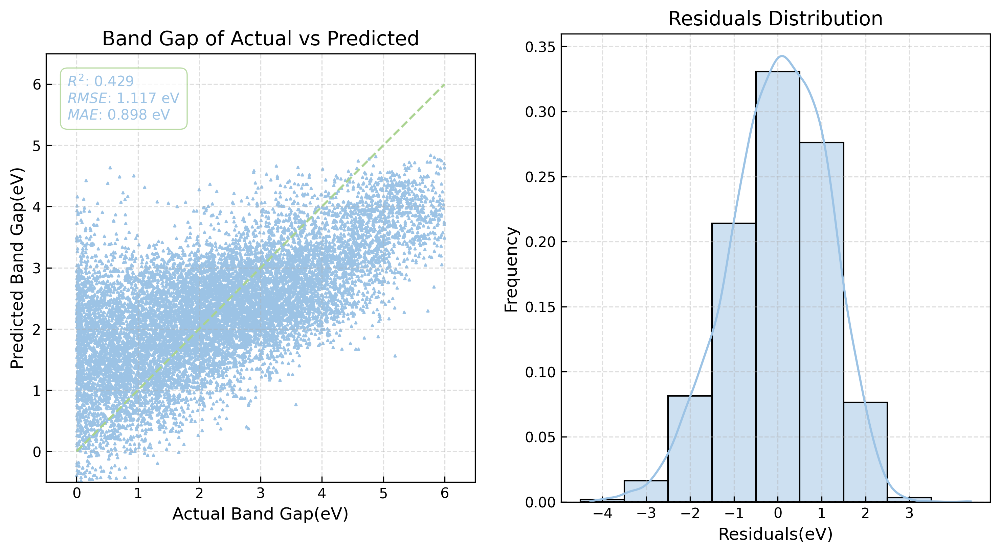


Model Evaluation Results:
Test set: R²: 0.4294 RMSE: 1.1165 MAE: 0.8978
Evaluating DFT ElasticNet on EXP test set:


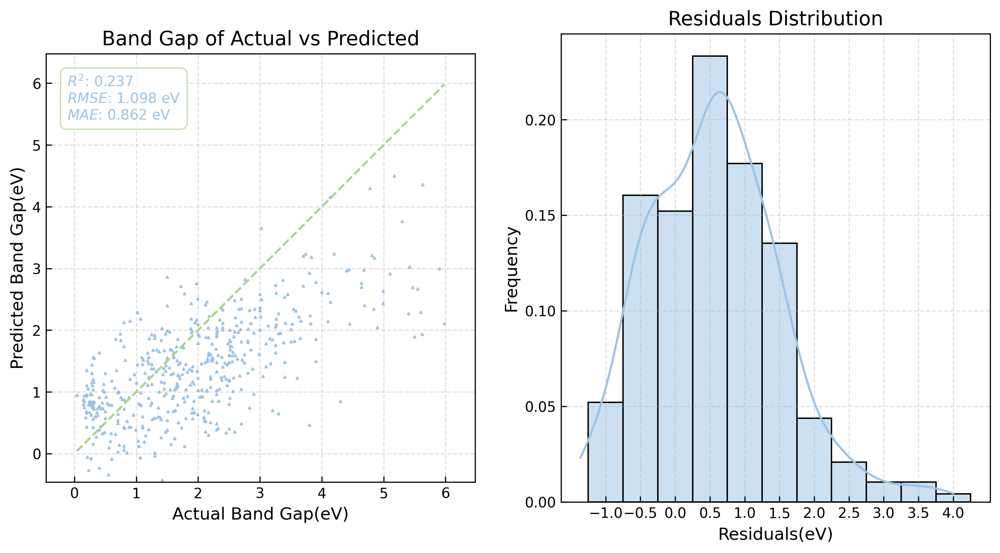


Model Evaluation Results:
Test set: R²: 0.2366 RMSE: 1.0980 MAE: 0.8615
####################################################################################################
[2/11 - DFT - Ridge] Training Ridge on DFT data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s
[Pipeline] ............. (step 2 of 2) Processing model, total=   0.1s
Model training completed!
Evaluating DFT Ridge on DFT test set:


/tmp/ipykernel_37730/2263416061.py:54: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  metrics_df = pd.concat([metrics_df, model_metrics], ignore_index=True)


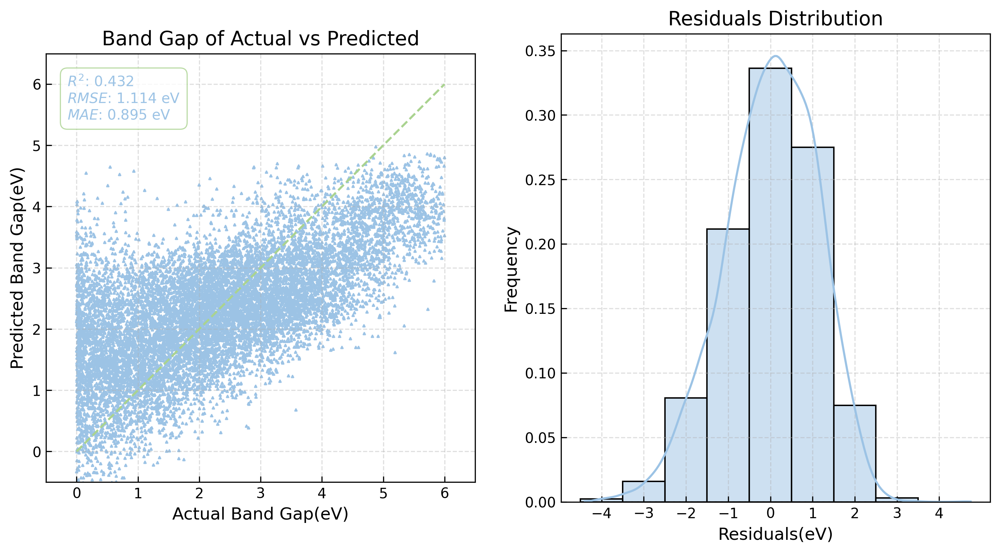


Model Evaluation Results:
Test set: R²: 0.4318 RMSE: 1.1142 MAE: 0.8947
Evaluating DFT Ridge on EXP test set:


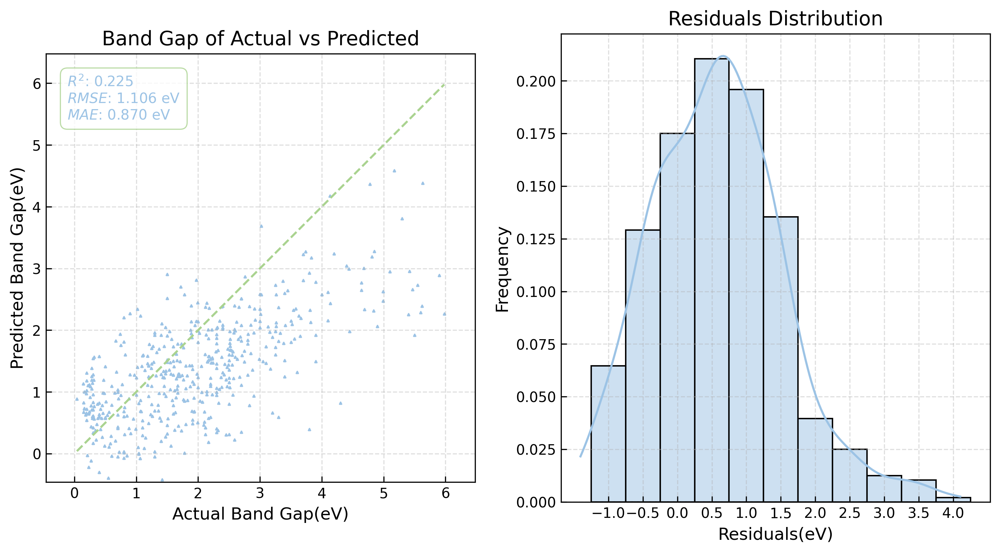


Model Evaluation Results:
Test set: R²: 0.2249 RMSE: 1.1064 MAE: 0.8698
####################################################################################################
[3/11 - DFT - Lasso] Training Lasso on DFT data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s
[Pipeline] ............. (step 2 of 2) Processing model, total=   0.1s
Model training completed!
Evaluating DFT Lasso on DFT test set:


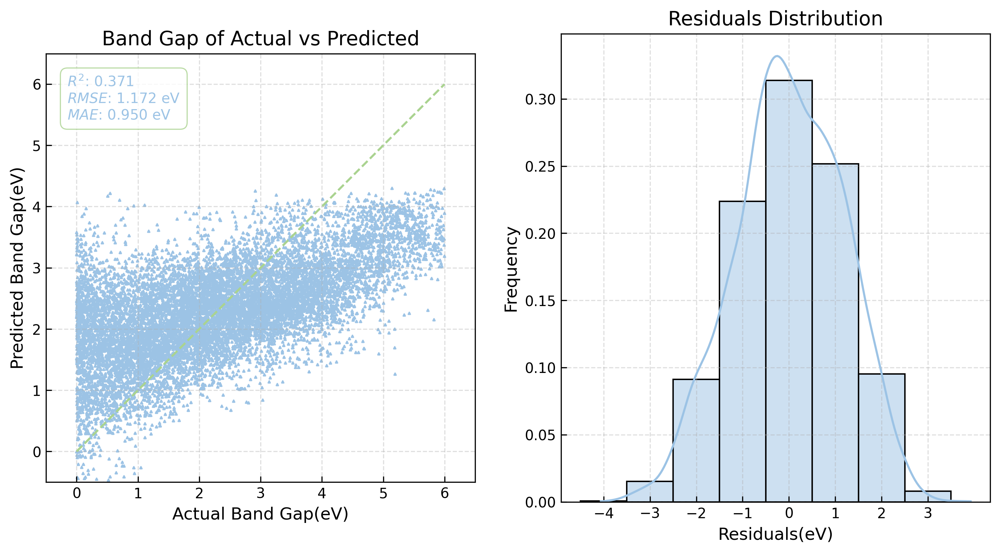


Model Evaluation Results:
Test set: R²: 0.3714 RMSE: 1.1719 MAE: 0.9497
Evaluating DFT Lasso on EXP test set:


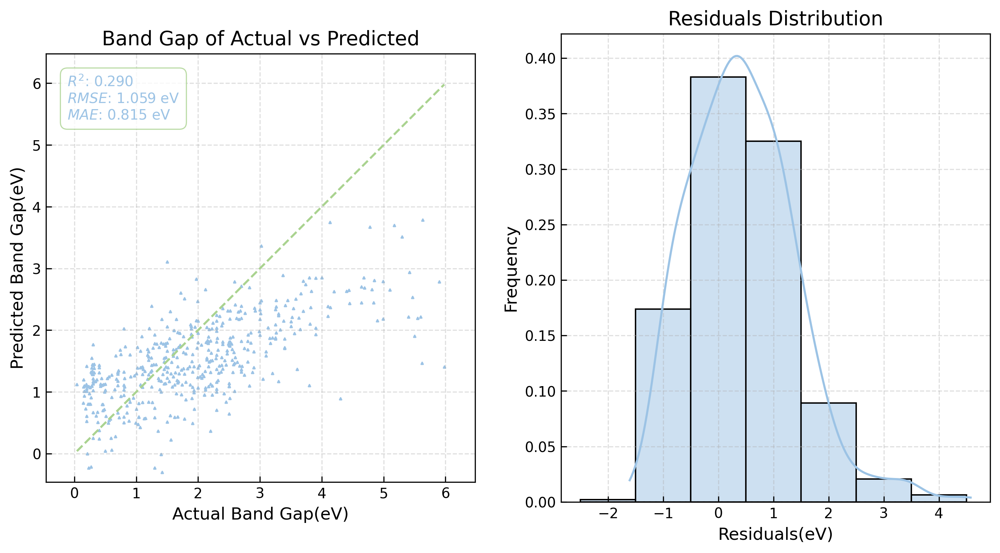


Model Evaluation Results:
Test set: R²: 0.2902 RMSE: 1.0588 MAE: 0.8151
####################################################################################################
[4/11 - DFT - GBR] Training GBR on DFT data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s
[Pipeline] ............. (step 2 of 2) Processing model, total= 2.9min
Model training completed!
Evaluating DFT GBR on DFT test set:


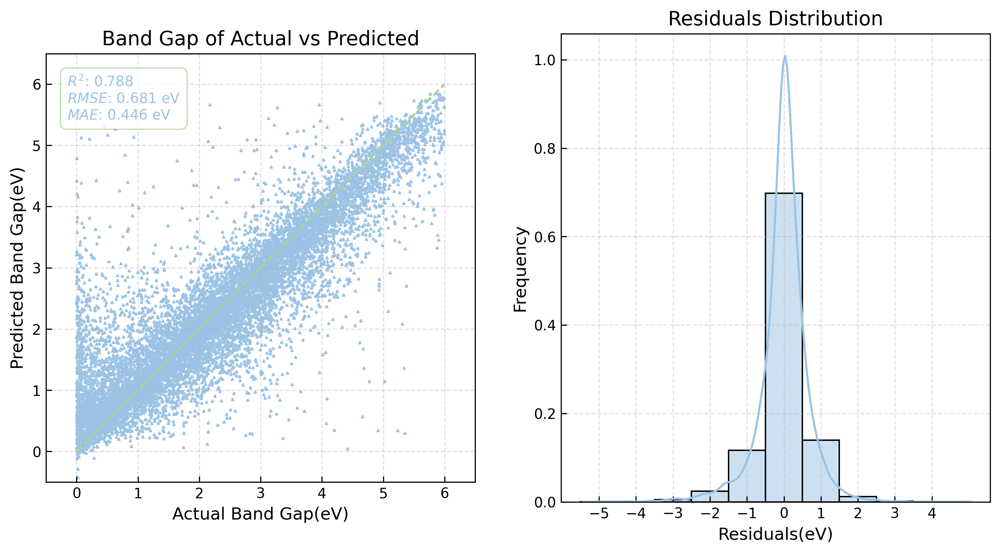


Model Evaluation Results:
Test set: R²: 0.7878 RMSE: 0.6810 MAE: 0.4460
Evaluating DFT GBR on EXP test set:


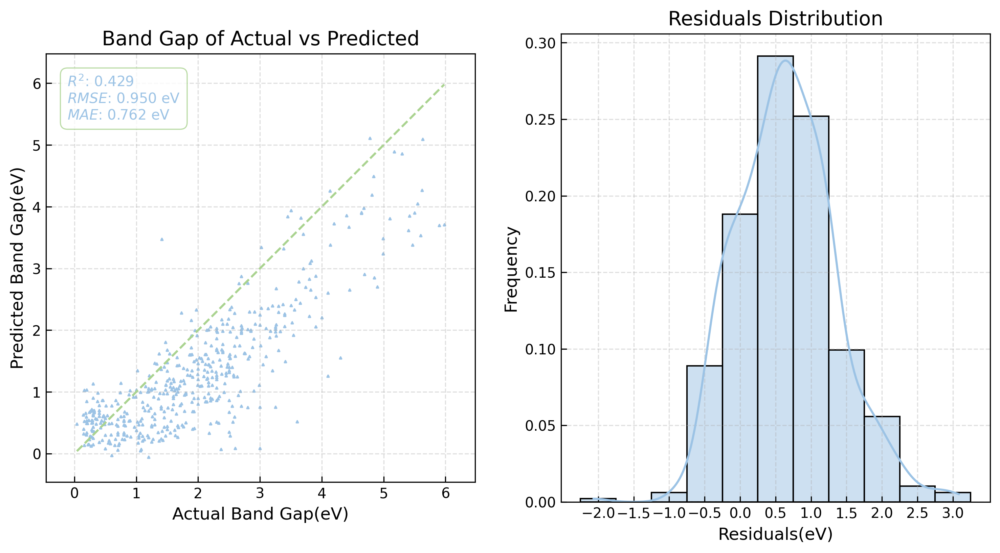


Model Evaluation Results:
Test set: R²: 0.4289 RMSE: 0.9497 MAE: 0.7624
####################################################################################################
[5/11 - DFT - LightGBM] Training LightGBM on DFT data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.1s
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.268873 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 11635
[LightGBM] [Info] Number of data points in the train set: 46514, number of used features: 102
[LightGBM] [Info] Start training from score 2.286416
[Pipeline] ............. (step 2 of 2) Processing model, total=   2.5s
Model training completed!
Evaluating DFT LightGBM on DFT test set:


/output/.pylibs/lib/python3.10/site-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


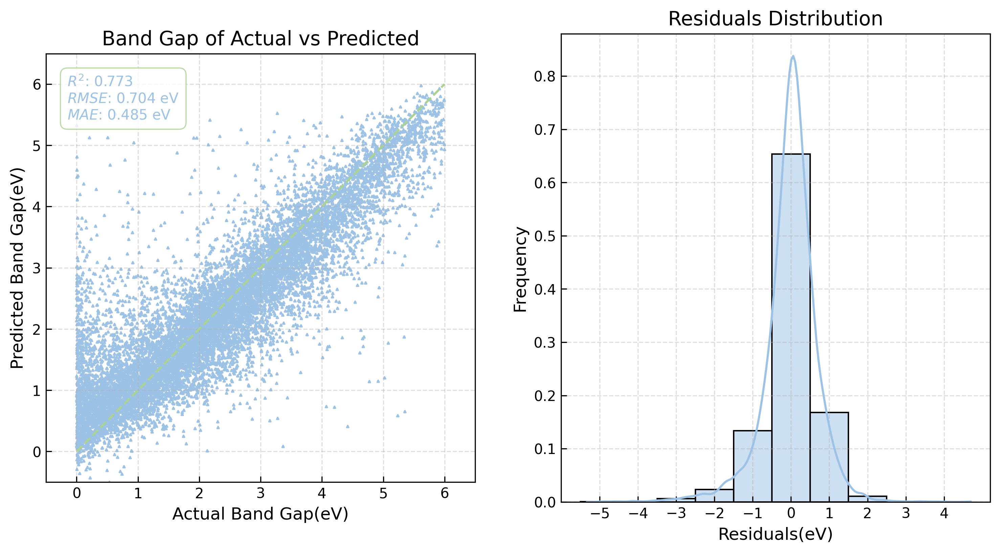


Model Evaluation Results:
Test set: R²: 0.7732 RMSE: 0.7039 MAE: 0.4851
Evaluating DFT LightGBM on EXP test set:


/output/.pylibs/lib/python3.10/site-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


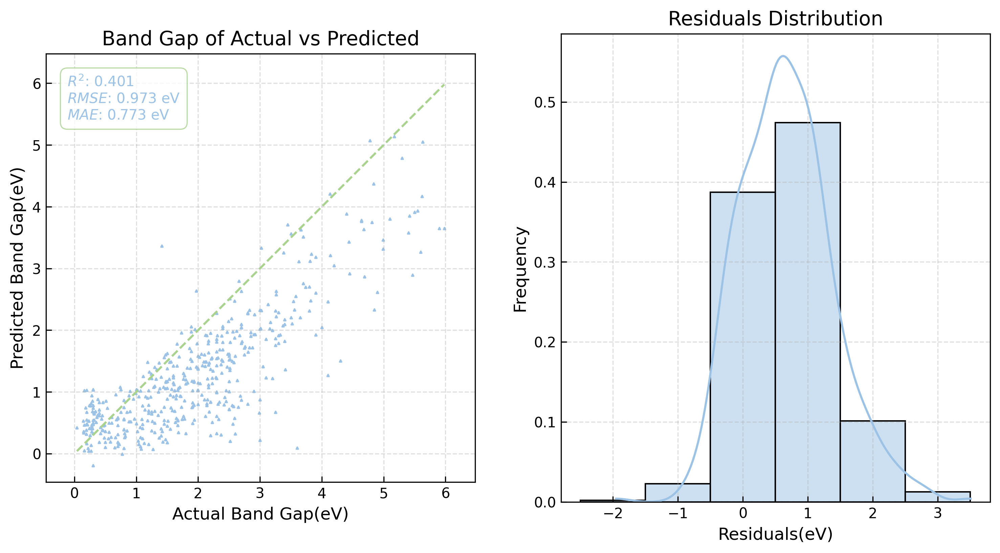


Model Evaluation Results:
Test set: R²: 0.4010 RMSE: 0.9726 MAE: 0.7726
Plotting feature importance for LightGBM on DFT data:


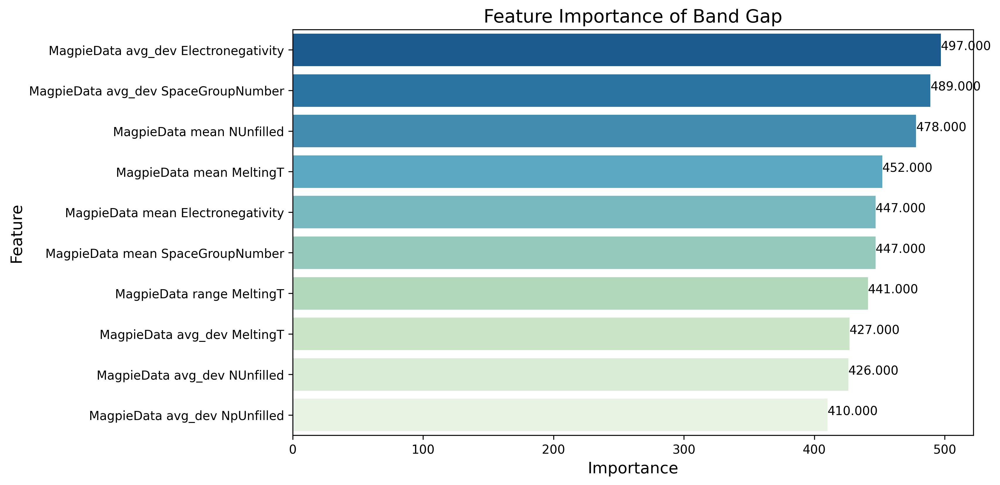

####################################################################################################
[6/11 - DFT - XGBoost] Training XGBoost on DFT data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s
[Pipeline] ............. (step 2 of 2) Processing model, total=   4.3s
Model training completed!
Evaluating DFT XGBoost on DFT test set:


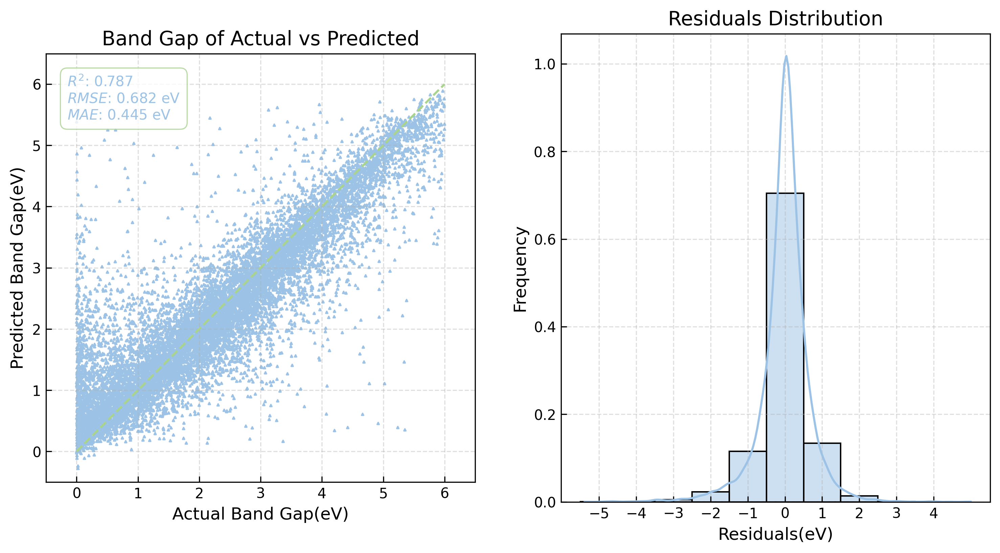


Model Evaluation Results:
Test set: R²: 0.7871 RMSE: 0.6820 MAE: 0.4449
Evaluating DFT XGBoost on EXP test set:


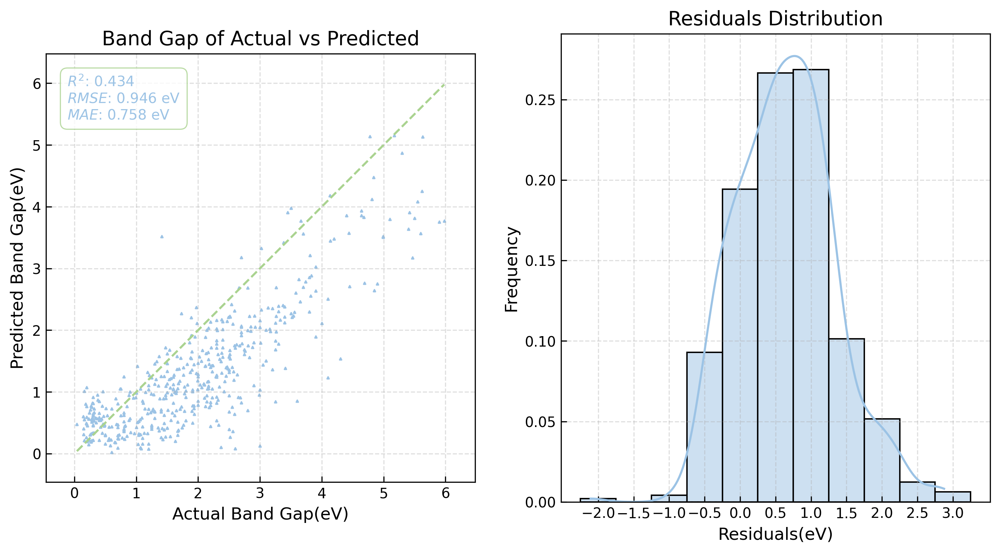


Model Evaluation Results:
Test set: R²: 0.4339 RMSE: 0.9455 MAE: 0.7584
Plotting feature importance for XGBoost on DFT data:


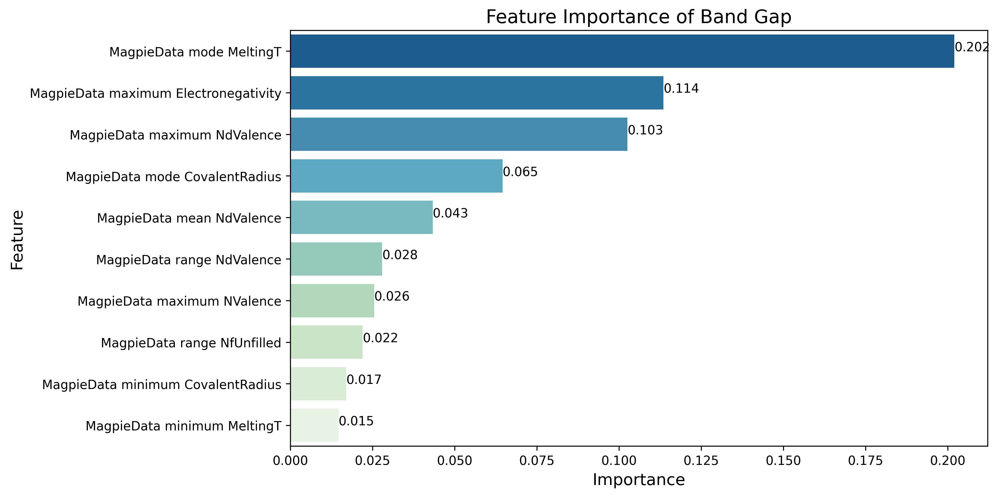

####################################################################################################
[7/11 - DFT - RandomForest] Training RandomForest on DFT data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.1s
[Pipeline] ............. (step 2 of 2) Processing model, total=  14.0s
Model training completed!
Evaluating DFT RandomForest on DFT test set:


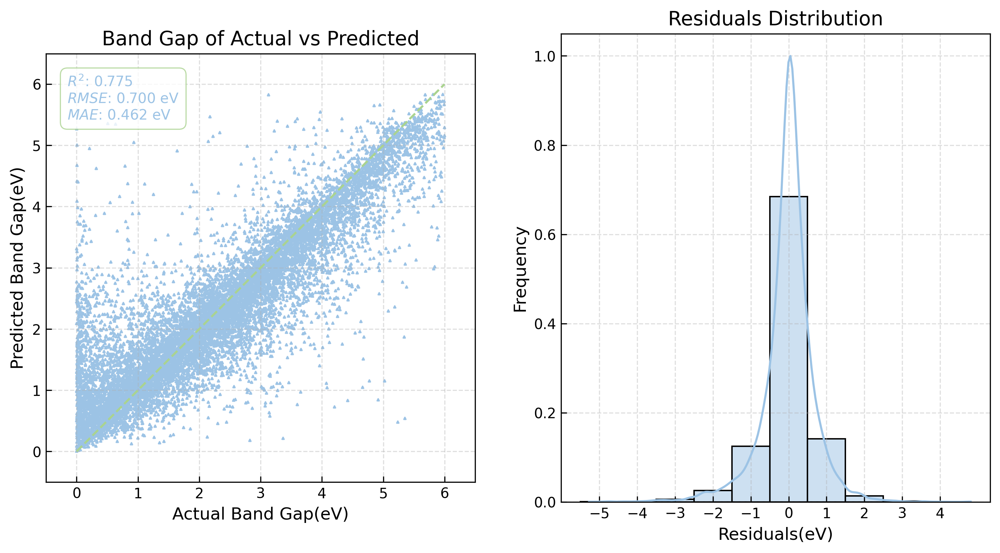


Model Evaluation Results:
Test set: R²: 0.7755 RMSE: 0.7004 MAE: 0.4619
Evaluating DFT RandomForest on EXP test set:


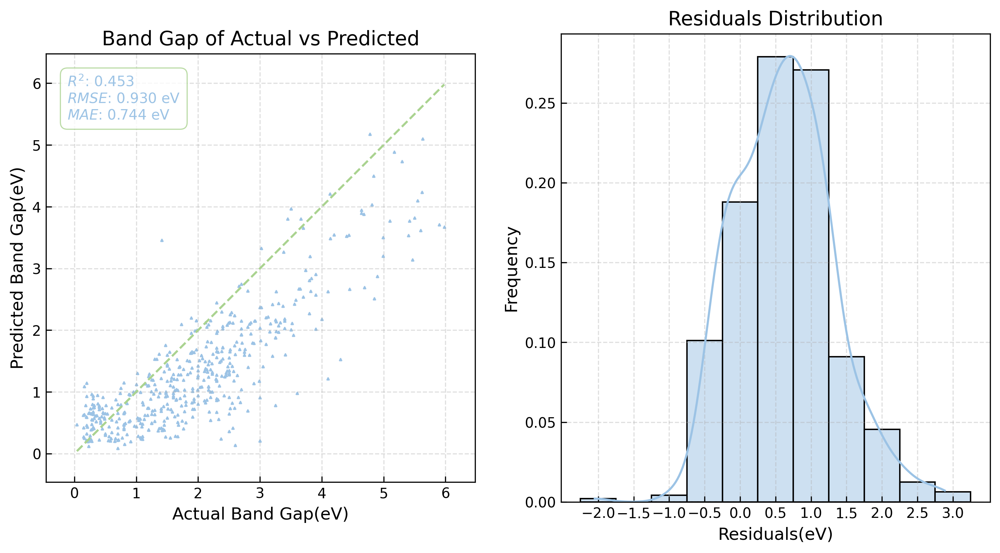


Model Evaluation Results:
Test set: R²: 0.4528 RMSE: 0.9296 MAE: 0.7436
Plotting feature importance for RandomForest on DFT data:


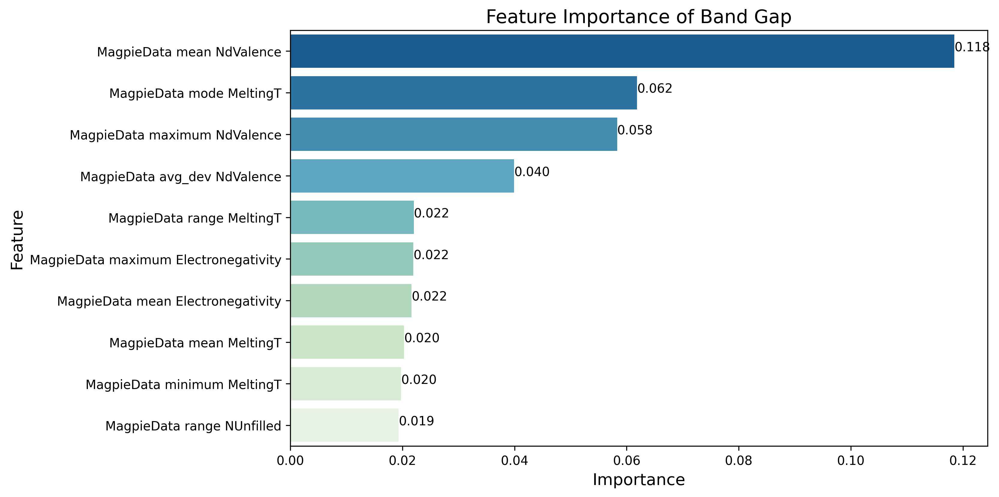

####################################################################################################
[8/11 - DFT - ExtraRandomTrees] Training ExtraRandomTrees on DFT data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s
[Pipeline] ............. (step 2 of 2) Processing model, total=   4.2s
Model training completed!
Evaluating DFT ExtraRandomTrees on DFT test set:


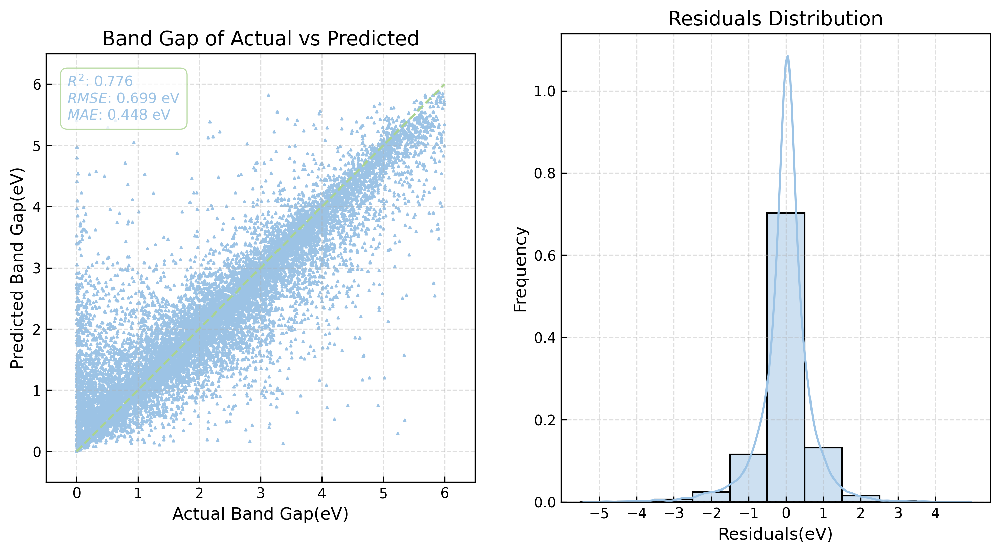


Model Evaluation Results:
Test set: R²: 0.7761 RMSE: 0.6994 MAE: 0.4484
Evaluating DFT ExtraRandomTrees on EXP test set:


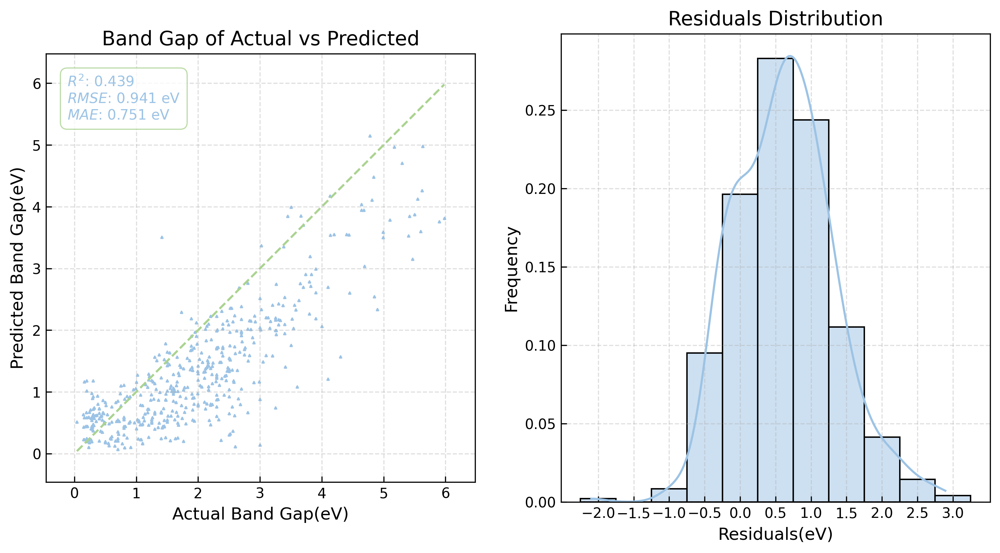


Model Evaluation Results:
Test set: R²: 0.4389 RMSE: 0.9414 MAE: 0.7512
Plotting feature importance for ExtraRandomTrees on DFT data:


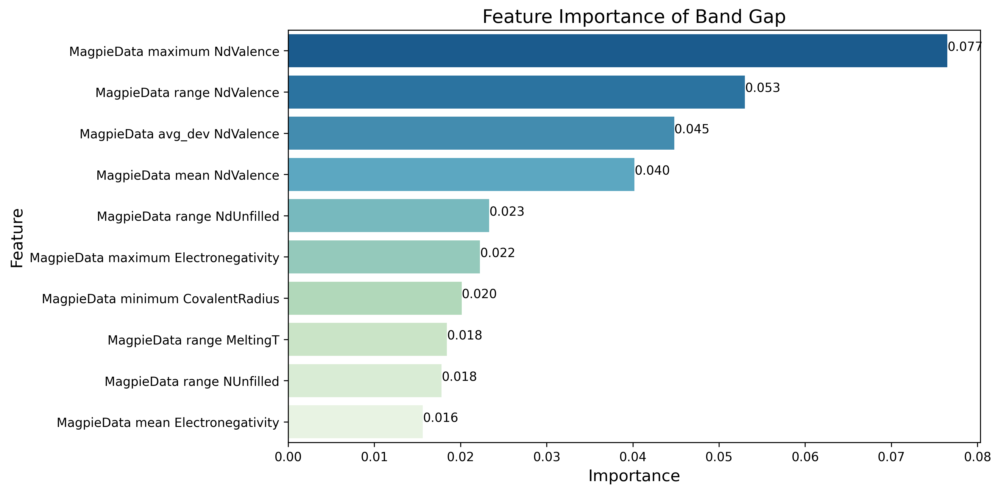

####################################################################################################
[9/11 - DFT - KNN] Training KNN on DFT data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s
[Pipeline] ............. (step 2 of 2) Processing model, total=   0.0s
Model training completed!
Evaluating DFT KNN on DFT test set:


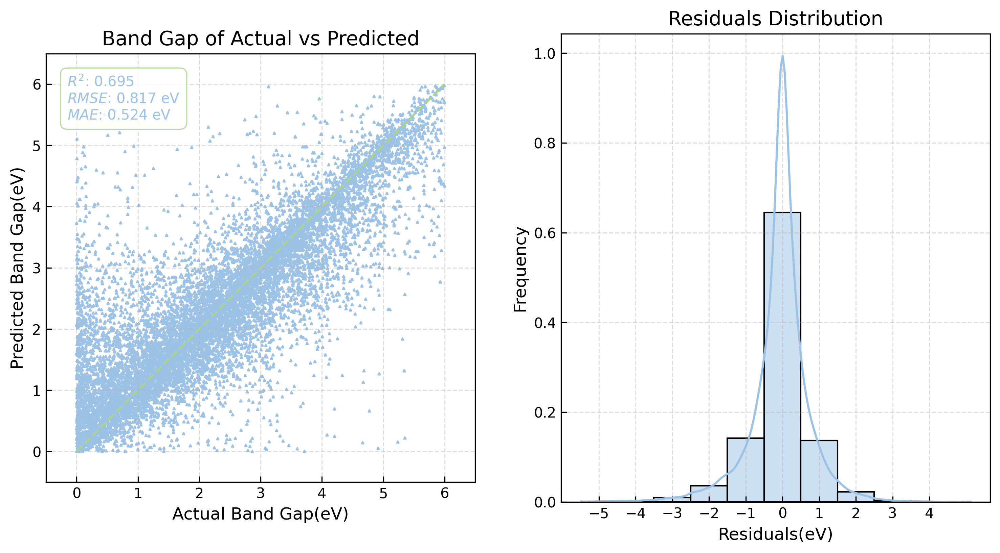


Model Evaluation Results:
Test set: R²: 0.6948 RMSE: 0.8166 MAE: 0.5242
Evaluating DFT KNN on EXP test set:


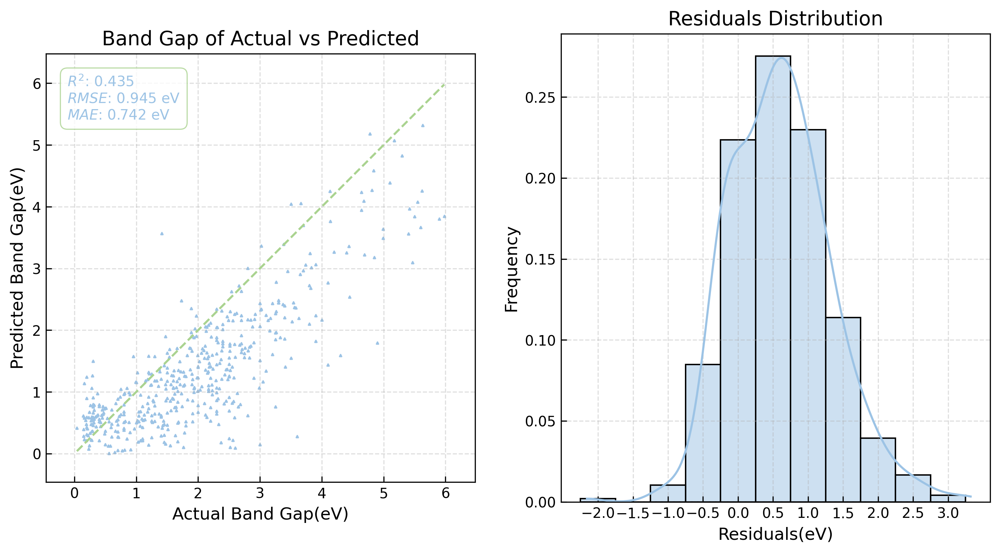


Model Evaluation Results:
Test set: R²: 0.4350 RMSE: 0.9446 MAE: 0.7416
####################################################################################################
[10/11 - DFT - KernelRidge] Training KernelRidge on DFT data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s
[Pipeline] ............. (step 2 of 2) Processing model, total=  54.5s
Model training completed!
Evaluating DFT KernelRidge on DFT test set:


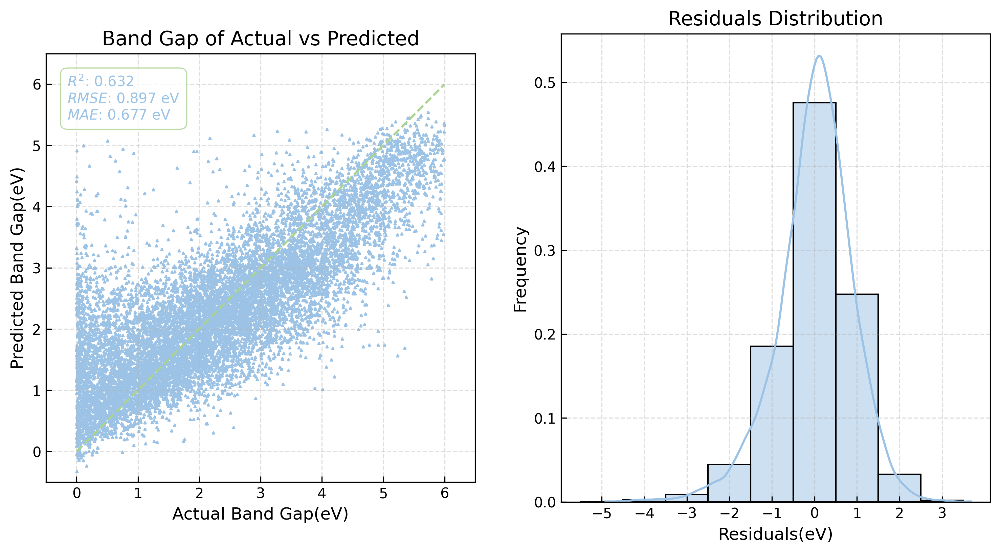


Model Evaluation Results:
Test set: R²: 0.6317 RMSE: 0.8970 MAE: 0.6770
Evaluating DFT KernelRidge on EXP test set:


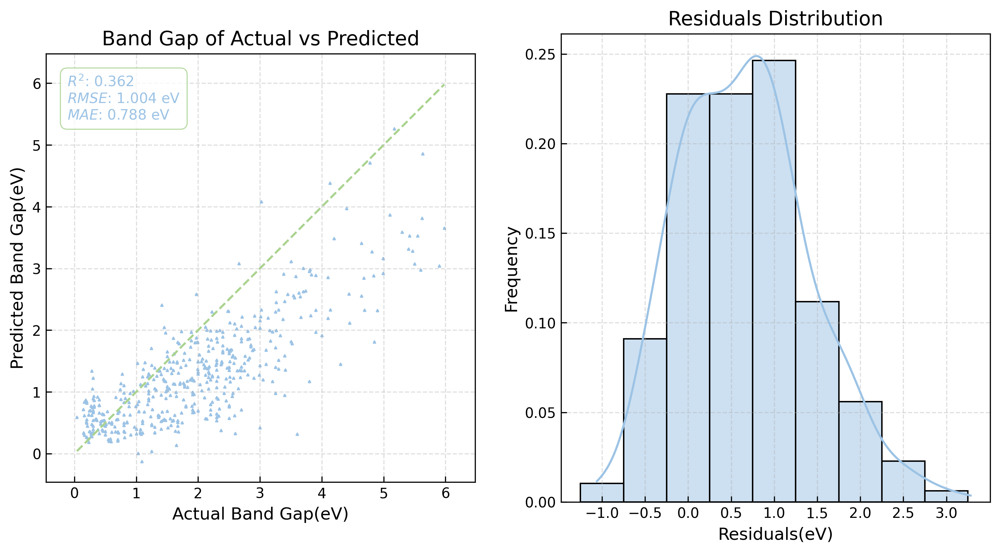


Model Evaluation Results:
Test set: R²: 0.3615 RMSE: 1.0041 MAE: 0.7884
####################################################################################################
[11/11 - DFT - SVR] Training SVR on DFT data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.1s
[Pipeline] ............. (step 2 of 2) Processing model, total=40.9min
Model training completed!
Evaluating DFT SVR on DFT test set:


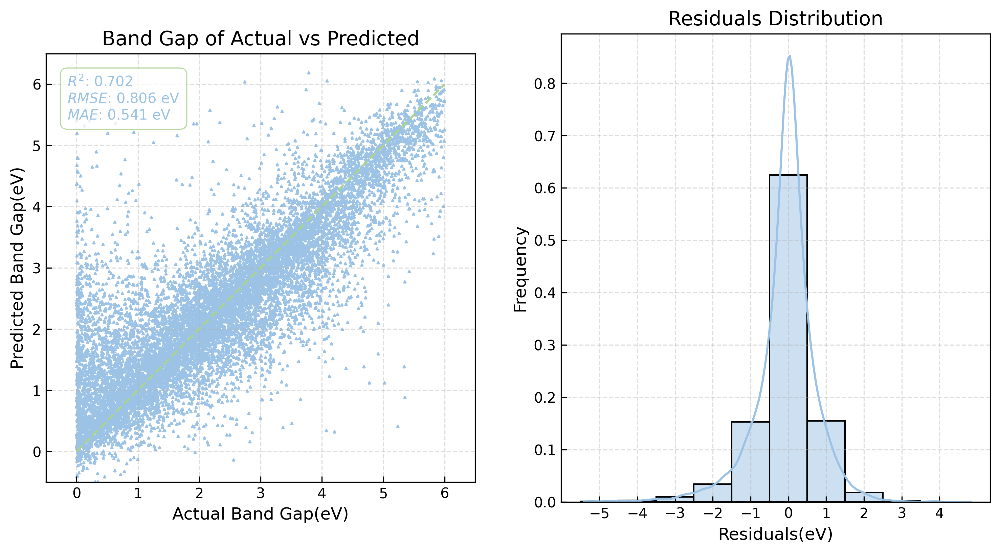


Model Evaluation Results:
Test set: R²: 0.7024 RMSE: 0.8064 MAE: 0.5414
Evaluating DFT SVR on EXP test set:


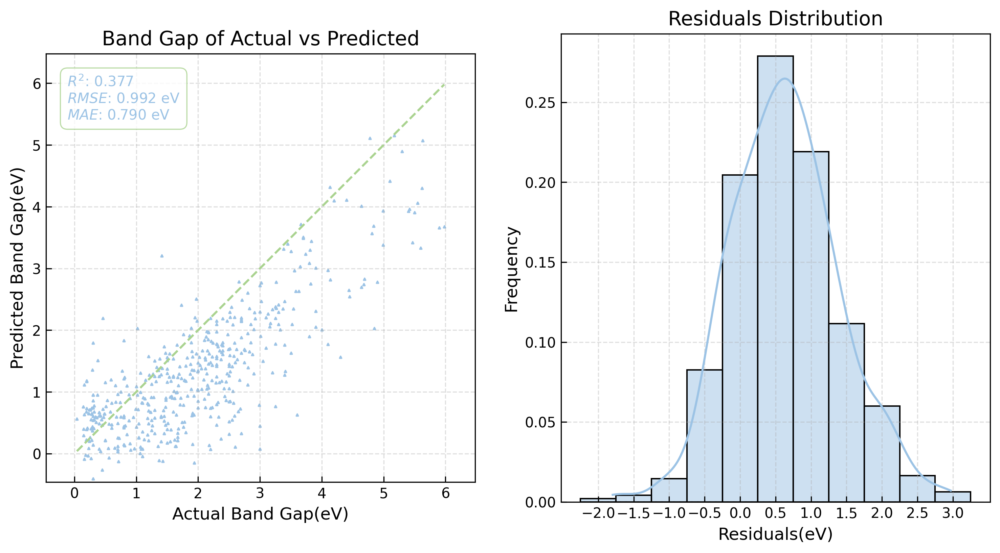


Model Evaluation Results:
Test set: R²: 0.3774 RMSE: 0.9916 MAE: 0.7903


In [11]:
model_number = 0
model_nums = len(dft_models)
# Loop through each model
for model_name, model in dft_models.items():
    model_number += 1
    # Create directories for saving models and figures
    file_path = os.path.join(current_path, model_name)
    fig_path = os.path.join(file_path, 'figures')
    model_path = os.path.join(file_path, 'model')
    # Create directories if they don't exist
    os.makedirs(file_path, exist_ok=True)
    os.makedirs(fig_path, exist_ok=True)
    os.makedirs(model_path, exist_ok=True)

    # record model metrics
    model_metrics = pd.DataFrame(columns=['Model', 'Train_set', 'Test_set', 'R²', 'RMSE', 'MAE'])
    # Train the model on dft data
    print("#" * 100)
    print(f"[{model_number}/{model_nums} - DFT - {model_name}] Training {model_name} on DFT data:")
    print("-" * 100)
    
    dft_model = SingleModel(clone(model), random_state=RANDOM_SEED)
    dft_model.train(dft_train_X, dft_train_y)
    # evaluate on the dft test set
    print(f"Evaluating DFT {model_name} on DFT test set:")
    
    metrics = dft_model.evaluate(dft_test_X, dft_test_y, fig_path=os.path.join(fig_path, 'dft_train_dft_test.png'))
    model_metrics.loc[len(model_metrics)] = {
    'Model': model_name,
    'Train_set': 'dft',
    'Test_set': 'dft',
    'R²': metrics['r2'],
    'RMSE': metrics['rmse'],
    'MAE': metrics['mae']
}
    # evaluate on the exp test set
    print(f"Evaluating DFT {model_name} on EXP test set:")
    metrics = dft_model.evaluate(exp_test_X, exp_test_y, fig_path=os.path.join(fig_path, 'dft_train_exp_test.png'))
    model_metrics.loc[len(model_metrics)] = {
    'Model': model_name,
    'Train_set': 'dft',
    'Test_set': 'exp',
    'R²': metrics['r2'],
    'RMSE': metrics['rmse'],
    'MAE': metrics['mae']
}
   
    # save models
    # dft_model.save_model(os.path.join(model_path, f'dft_{model_name}.pkl'))
    
    # # save model metrics
    # model_metrics.to_csv(os.path.join(file_path, f'{model_name}_metrics.csv'), index=False)
    # append model metrics to the main metrics dataframe
    metrics_df = pd.concat([metrics_df, model_metrics], ignore_index=True)
    #################################################
    # Feature importance plot
    # For models that support feature importance
    if model_name in ['LightGBM', 'XGBoost', 'RandomForest', 'ExtraRandomTrees']:
        # 
        print(f"Plotting feature importance for {model_name} on DFT data:")
        dft_importances_df = plot_feature_importance(dft_model.get_model(), dft_train_X.columns, top_n=10,
                            fig_path=os.path.join(fig_path, f'dft_feature_importance.png'))

### EXP Model Train

####################################################################################################
[1/11 - EXP - ElasticNet] Training ElasticNet on EXP data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s
[Pipeline] ............. (step 2 of 2) Processing model, total=   0.0s
Model training completed!
Evaluating EXP ElasticNet on EXP test set:


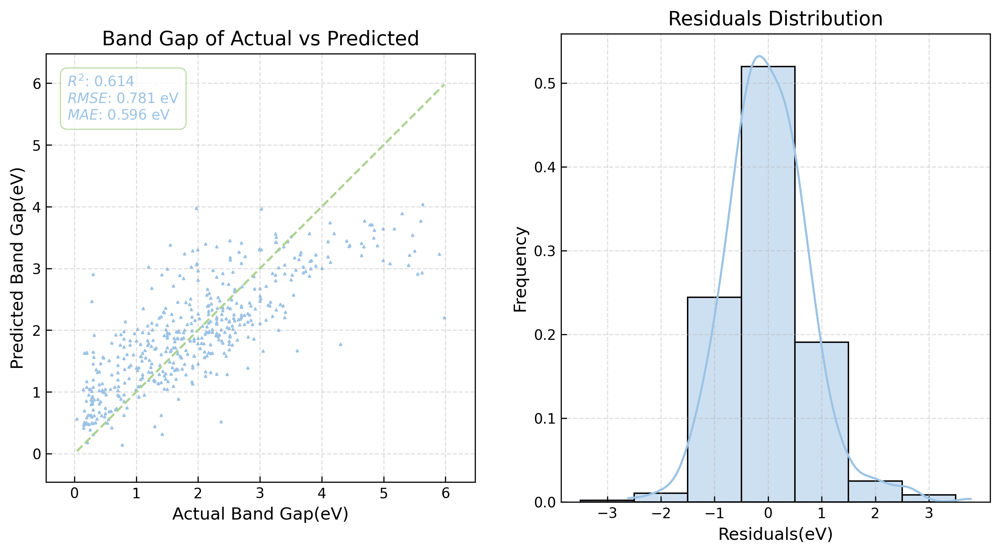


Model Evaluation Results:
Test set: R²: 0.6136 RMSE: 0.7811 MAE: 0.5959
Evaluating EXP ElasticNet on DFT test set:


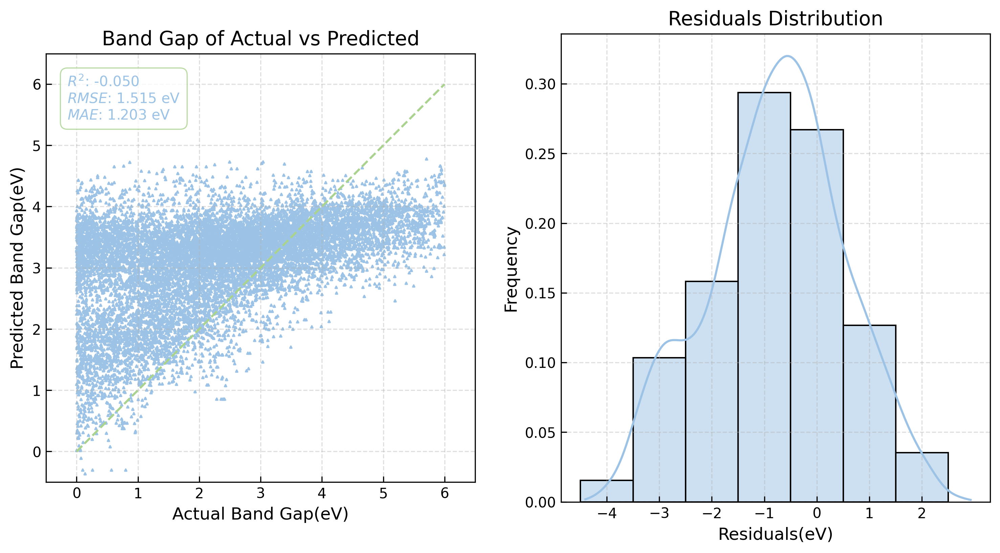


Model Evaluation Results:
Test set: R²: -0.0499 RMSE: 1.5146 MAE: 1.2034
####################################################################################################
[2/11 - EXP - Ridge] Training Ridge on EXP data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s
[Pipeline] ............. (step 2 of 2) Processing model, total=   0.0s
Model training completed!
Evaluating EXP Ridge on EXP test set:


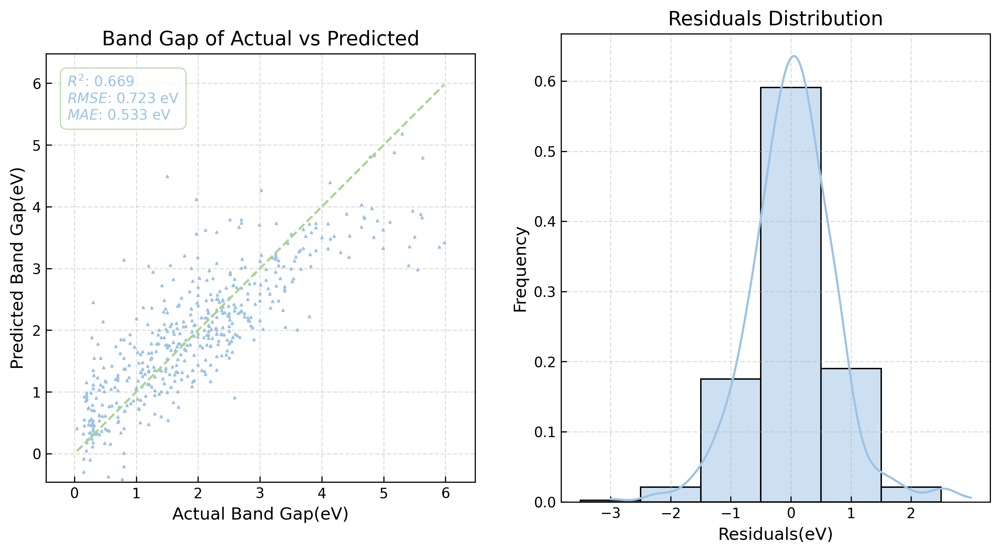


Model Evaluation Results:
Test set: R²: 0.6686 RMSE: 0.7234 MAE: 0.5330
Evaluating EXP Ridge on DFT test set:


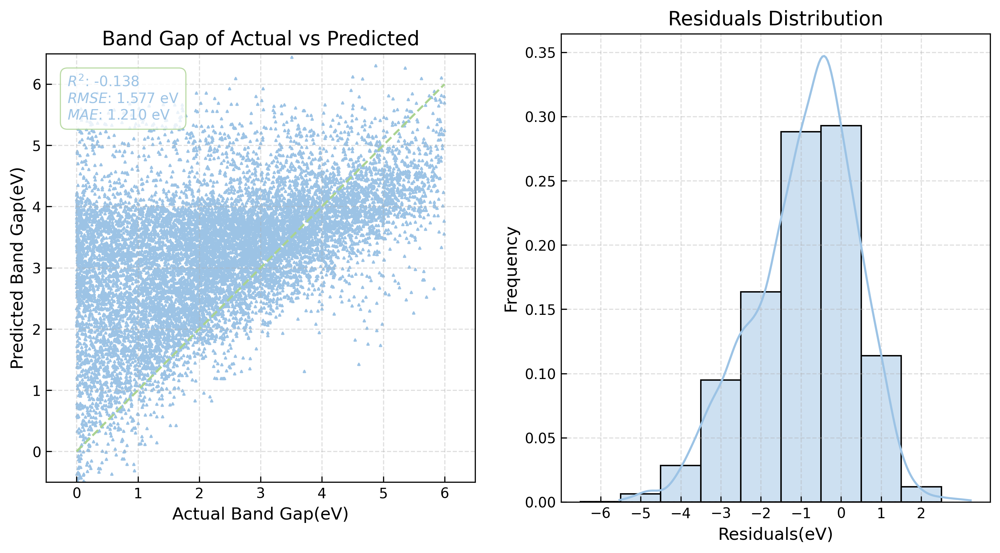


Model Evaluation Results:
Test set: R²: -0.1378 RMSE: 1.5767 MAE: 1.2100
####################################################################################################
[3/11 - EXP - Lasso] Training Lasso on EXP data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s
[Pipeline] ............. (step 2 of 2) Processing model, total=   0.0s
Model training completed!
Evaluating EXP Lasso on EXP test set:


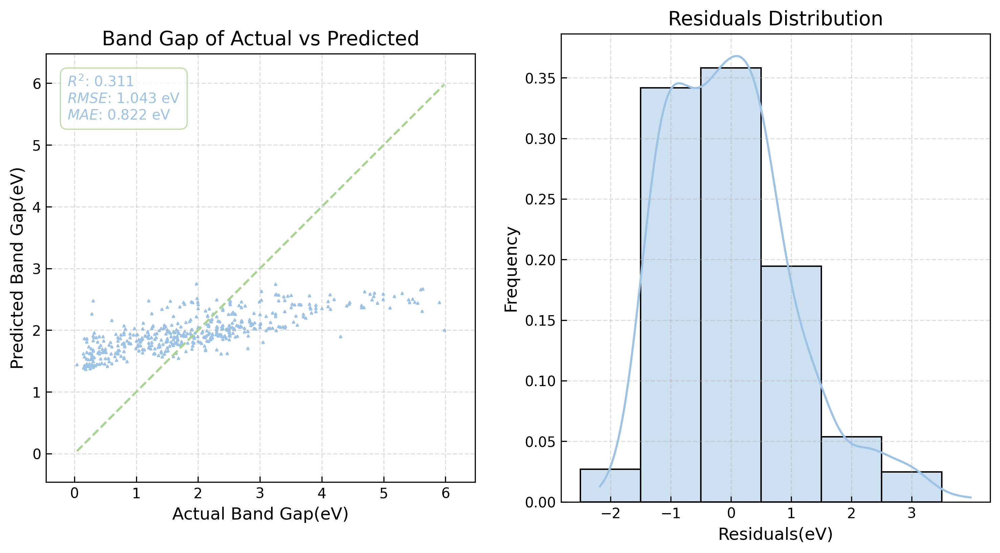


Model Evaluation Results:
Test set: R²: 0.3105 RMSE: 1.0435 MAE: 0.8220
Evaluating EXP Lasso on DFT test set:


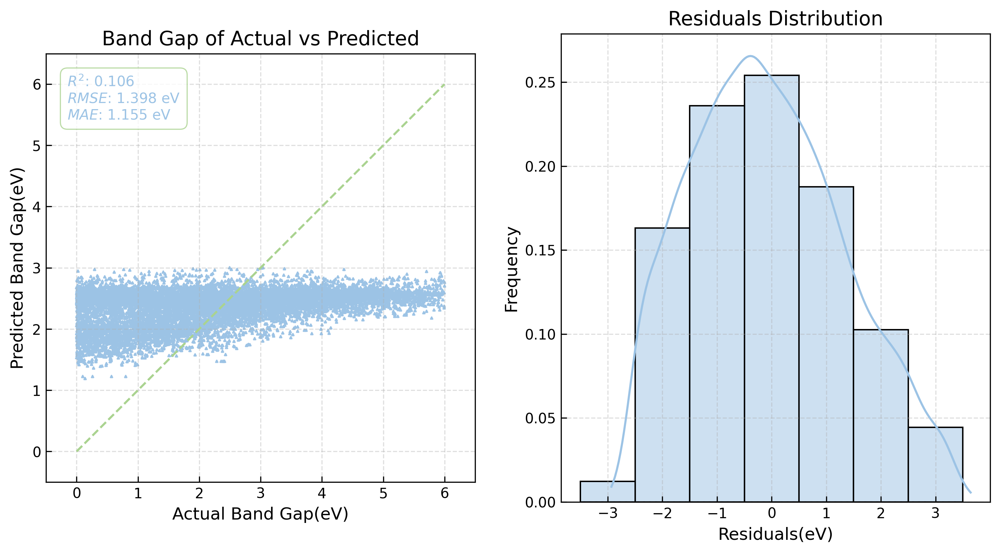


Model Evaluation Results:
Test set: R²: 0.1059 RMSE: 1.3977 MAE: 1.1551
####################################################################################################
[4/11 - EXP - GBR] Training GBR on EXP data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s
[Pipeline] ............. (step 2 of 2) Processing model, total=  12.1s
Model training completed!
Evaluating EXP GBR on EXP test set:


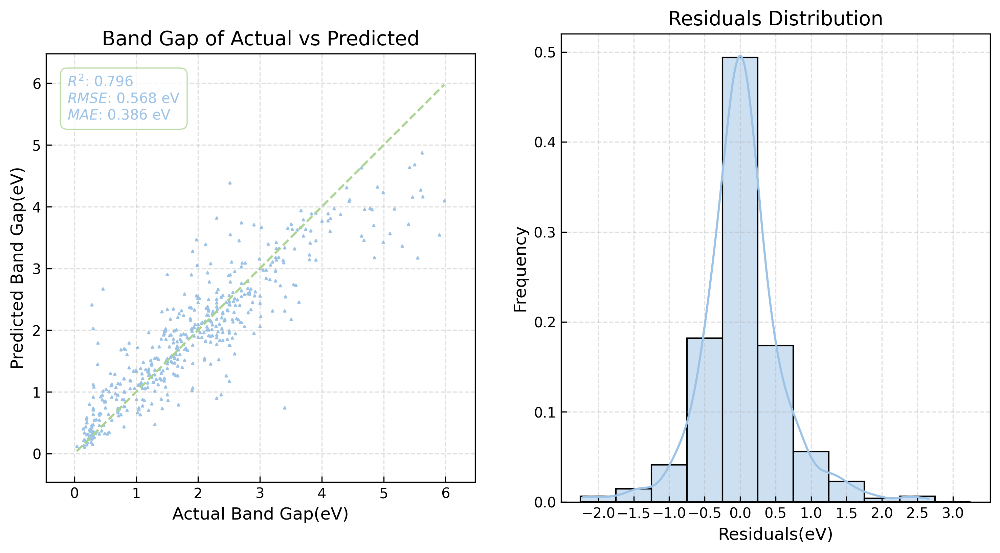


Model Evaluation Results:
Test set: R²: 0.7959 RMSE: 0.5678 MAE: 0.3862
Evaluating EXP GBR on DFT test set:


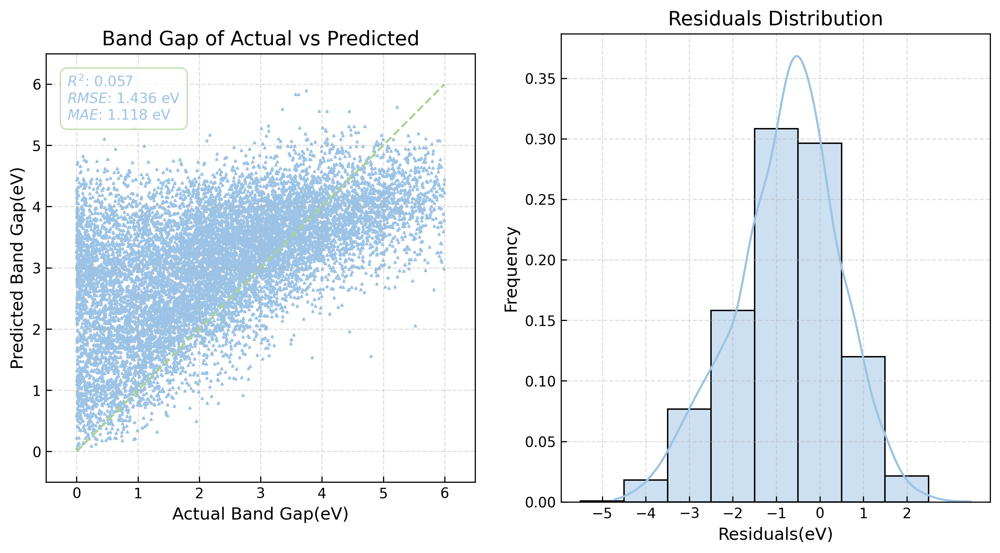


Model Evaluation Results:
Test set: R²: 0.0567 RMSE: 1.4356 MAE: 1.1177
####################################################################################################
[5/11 - EXP - LightGBM] Training LightGBM on EXP data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.320122 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 10131
[LightGBM] [Info] Number of data points in the train set: 1933, number of used features: 97
[LightGBM] [Info] Start training from score 1.968339
[Pipeline] ............. (step 2 of 2) Processing model, total=14.1min
Model training completed!
Evaluating EXP LightGBM on EXP test set:


/output/.pylibs/lib/python3.10/site-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


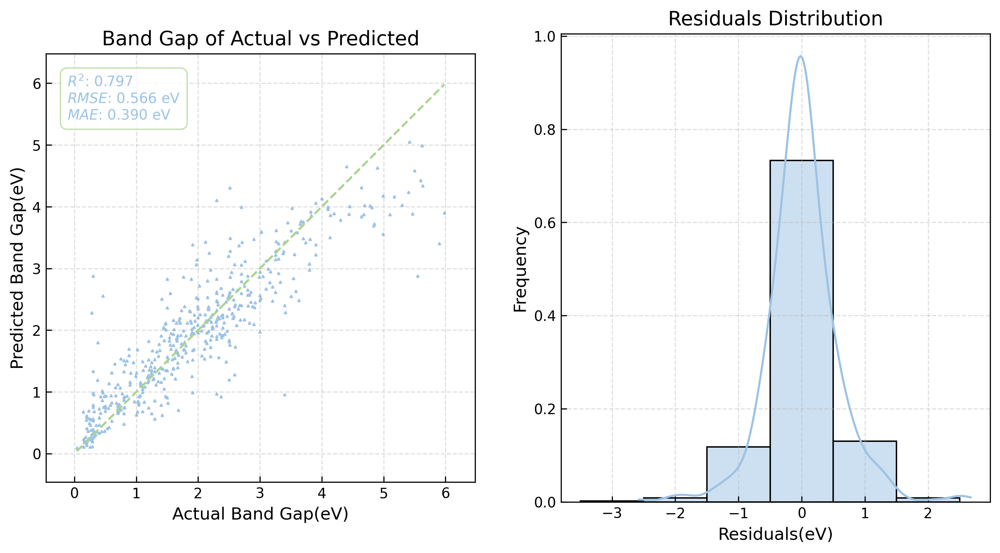


Model Evaluation Results:
Test set: R²: 0.7973 RMSE: 0.5658 MAE: 0.3898
Evaluating EXP LightGBM on DFT test set:


/output/.pylibs/lib/python3.10/site-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


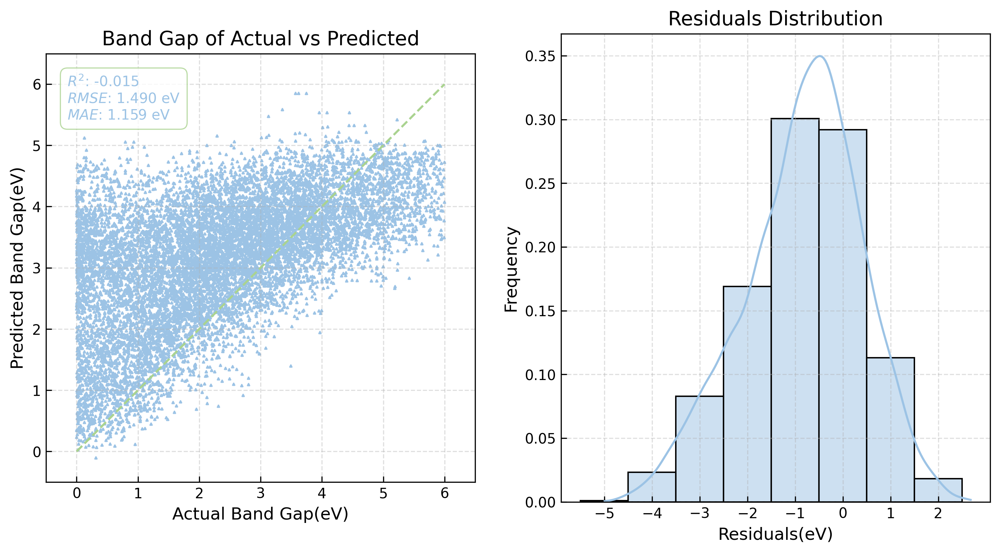


Model Evaluation Results:
Test set: R²: -0.0154 RMSE: 1.4895 MAE: 1.1594
Plotting feature importance for LightGBM on EXP data:


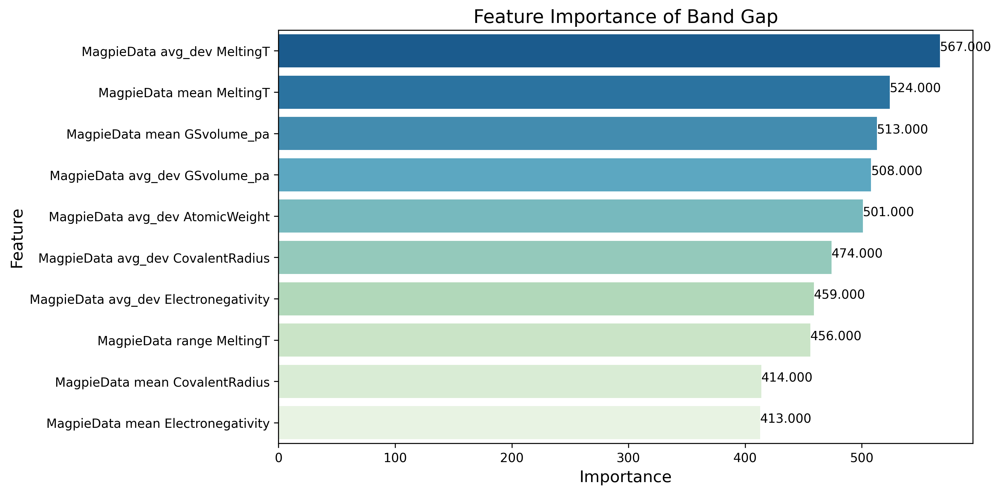

####################################################################################################
[6/11 - EXP - XGBoost] Training XGBoost on EXP data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s
[Pipeline] ............. (step 2 of 2) Processing model, total=   0.6s
Model training completed!
Evaluating EXP XGBoost on EXP test set:


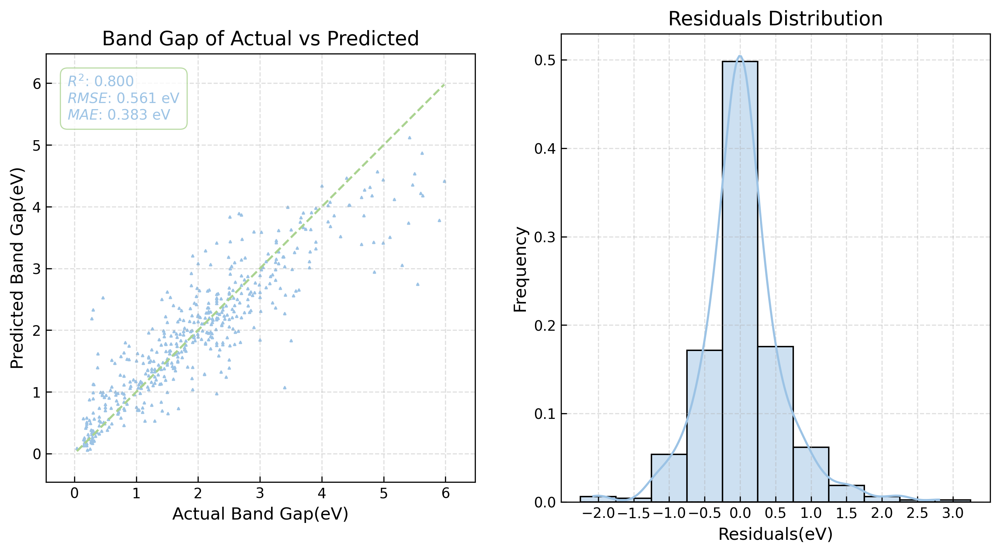


Model Evaluation Results:
Test set: R²: 0.8005 RMSE: 0.5613 MAE: 0.3832
Evaluating EXP XGBoost on DFT test set:


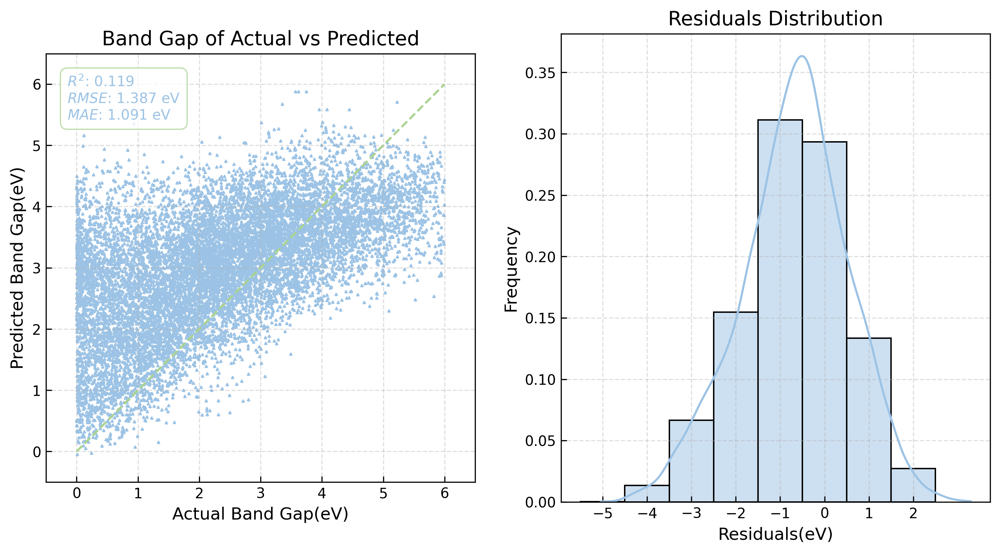


Model Evaluation Results:
Test set: R²: 0.1191 RMSE: 1.3873 MAE: 1.0914
Plotting feature importance for XGBoost on EXP data:


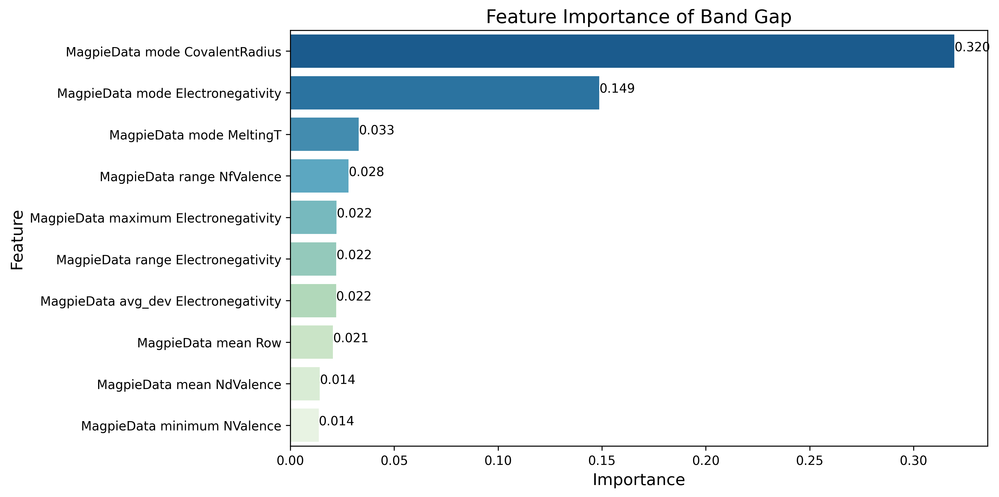

####################################################################################################
[7/11 - EXP - RandomForest] Training RandomForest on EXP data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s
[Pipeline] ............. (step 2 of 2) Processing model, total=   1.2s
Model training completed!
Evaluating EXP RandomForest on EXP test set:


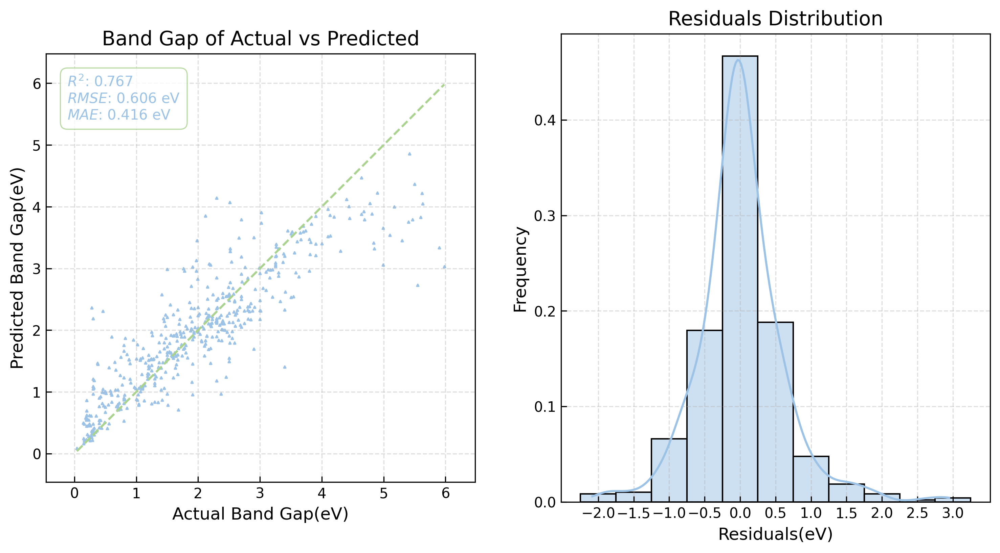


Model Evaluation Results:
Test set: R²: 0.7671 RMSE: 0.6064 MAE: 0.4161
Evaluating EXP RandomForest on DFT test set:


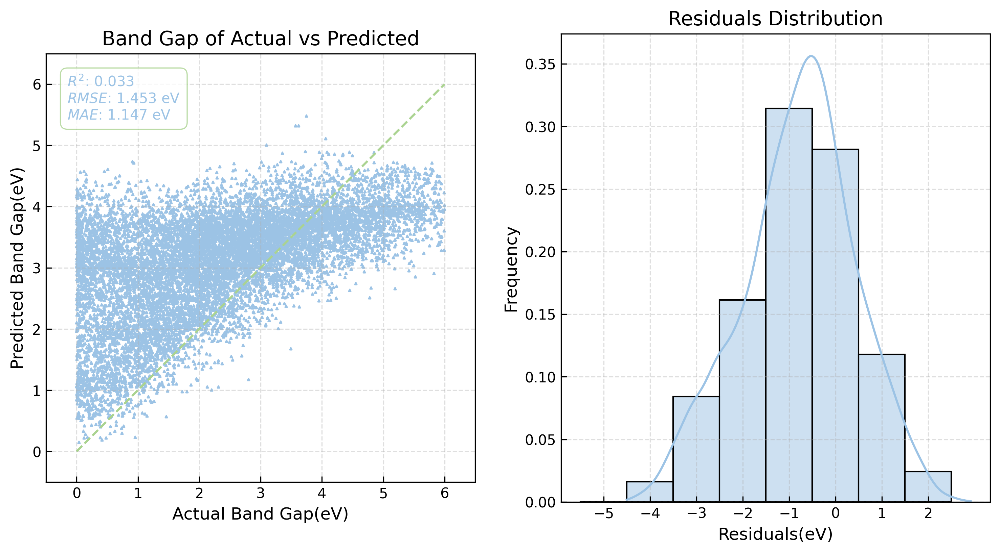


Model Evaluation Results:
Test set: R²: 0.0331 RMSE: 1.4535 MAE: 1.1467
Plotting feature importance for RandomForest on EXP data:


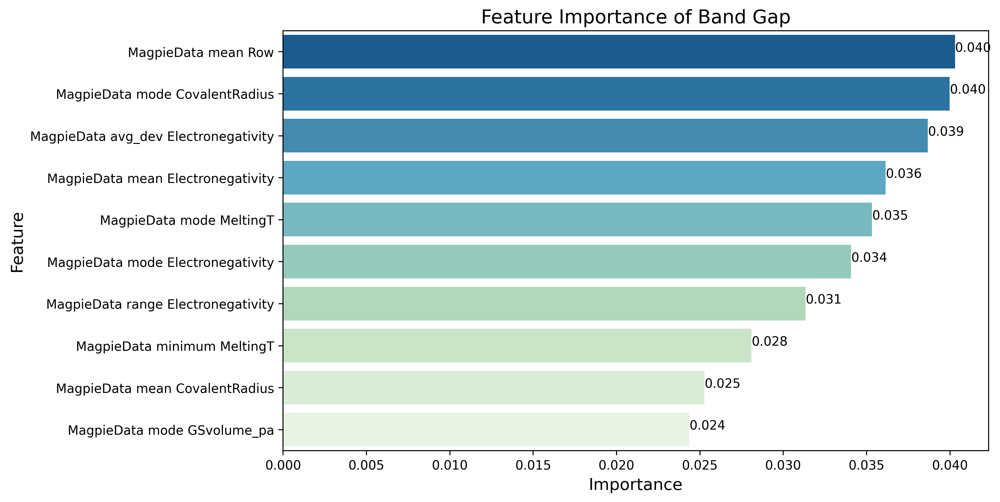

####################################################################################################
[8/11 - EXP - ExtraRandomTrees] Training ExtraRandomTrees on EXP data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s
[Pipeline] ............. (step 2 of 2) Processing model, total=   0.4s
Model training completed!
Evaluating EXP ExtraRandomTrees on EXP test set:


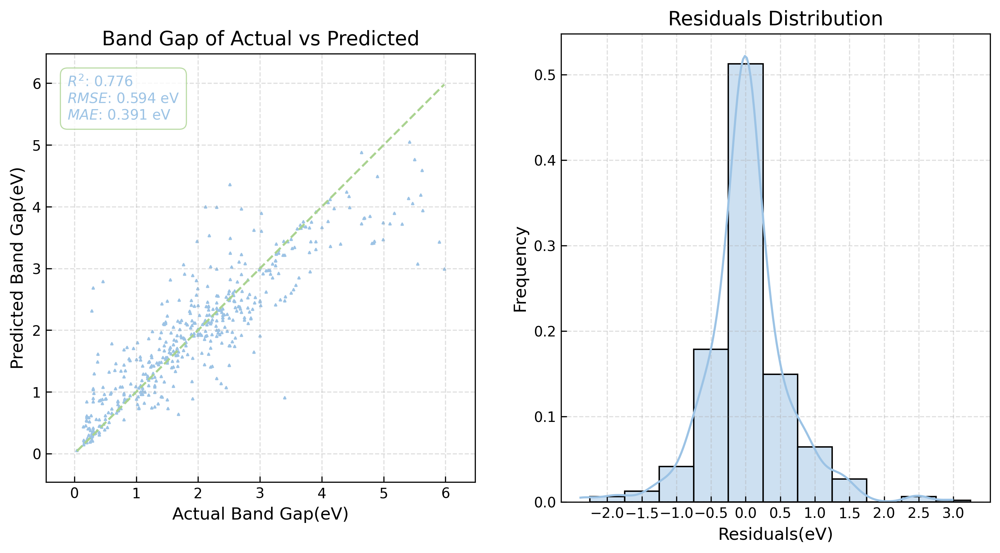


Model Evaluation Results:
Test set: R²: 0.7763 RMSE: 0.5944 MAE: 0.3906
Evaluating EXP ExtraRandomTrees on DFT test set:


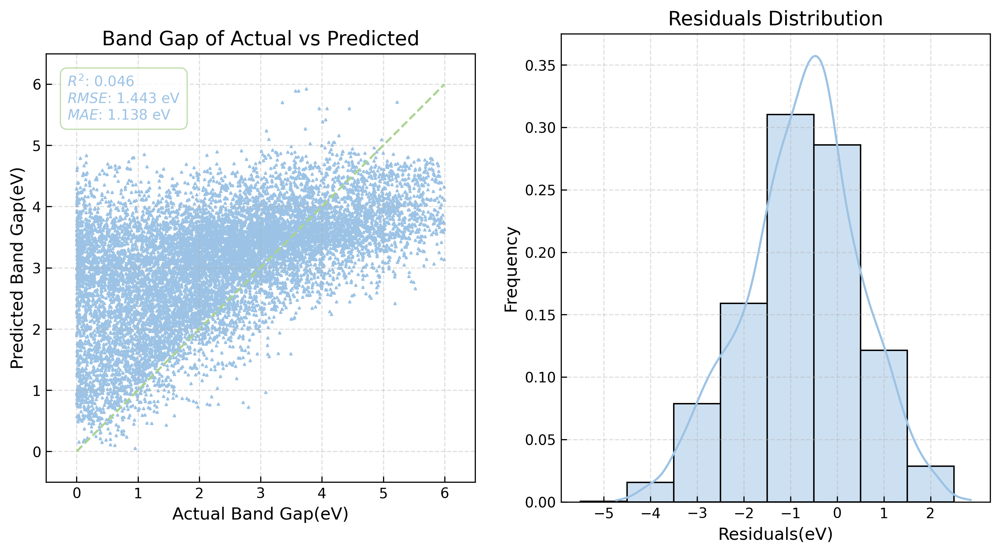


Model Evaluation Results:
Test set: R²: 0.0465 RMSE: 1.4434 MAE: 1.1375
Plotting feature importance for ExtraRandomTrees on EXP data:


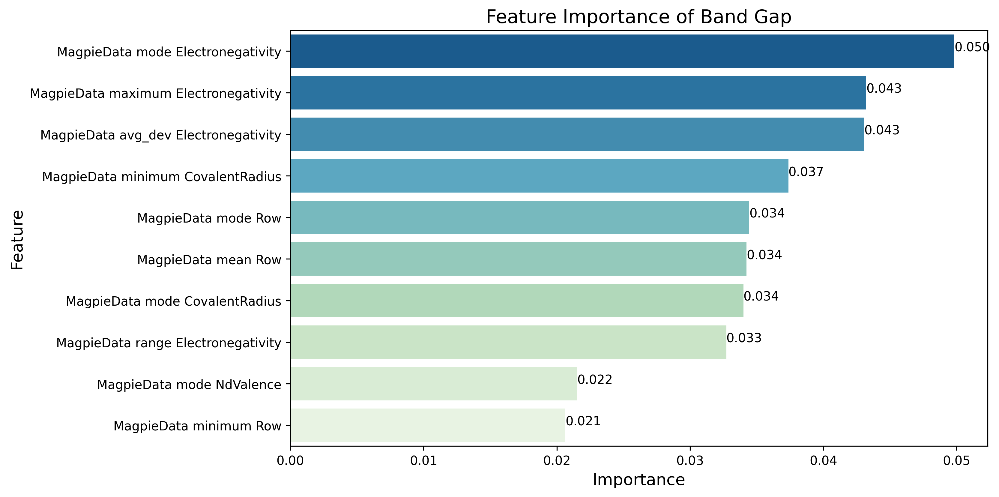

####################################################################################################
[9/11 - EXP - KNN] Training KNN on EXP data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s
[Pipeline] ............. (step 2 of 2) Processing model, total=   0.0s
Model training completed!
Evaluating EXP KNN on EXP test set:


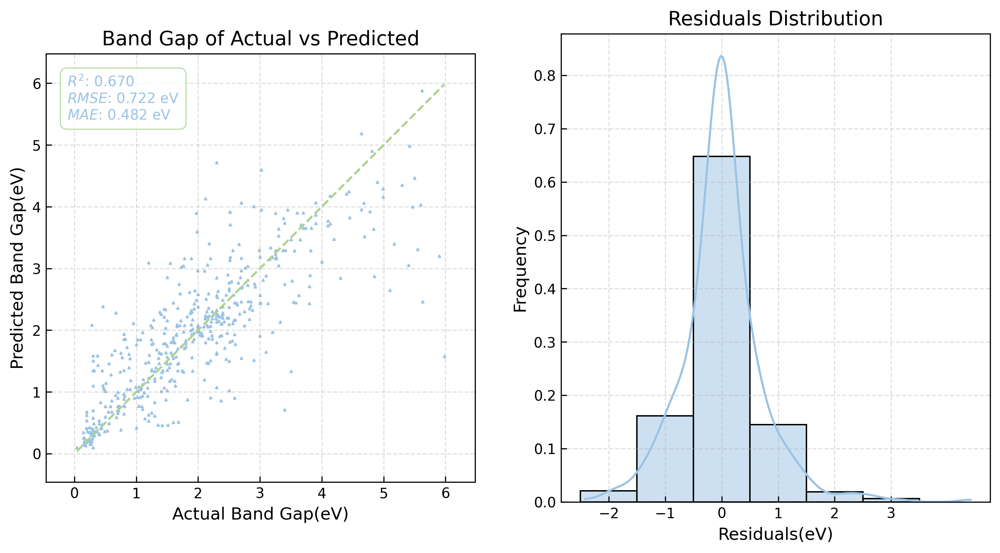


Model Evaluation Results:
Test set: R²: 0.6703 RMSE: 0.7216 MAE: 0.4822
Evaluating EXP KNN on DFT test set:


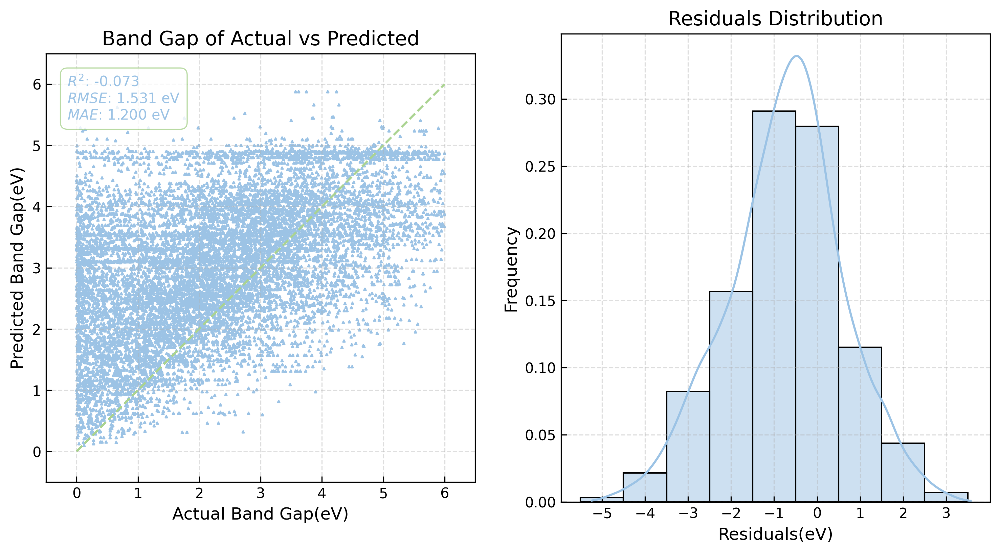


Model Evaluation Results:
Test set: R²: -0.0731 RMSE: 1.5312 MAE: 1.1999
####################################################################################################
[10/11 - EXP - KernelRidge] Training KernelRidge on EXP data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s


/output/.pylibs/lib/python3.10/site-packages/sklearn/kernel_approximation.py:1020: UserWarning: n_components > n_samples. This is not possible.
n_components was set to n_samples, which results in inefficient evaluation of the full kernel.
  warnings.warn(


[Pipeline] ............. (step 2 of 2) Processing model, total=   1.5s
Model training completed!
Evaluating EXP KernelRidge on EXP test set:


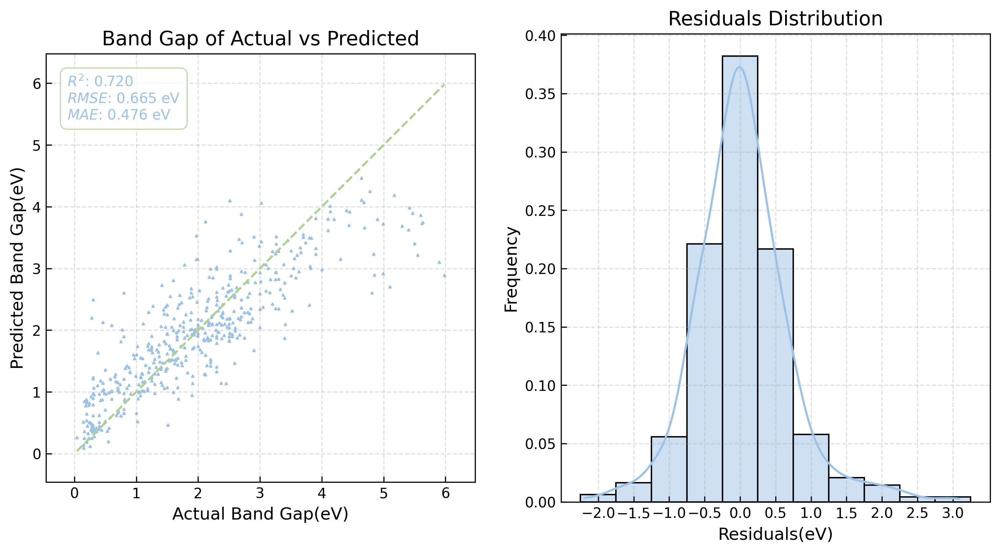


Model Evaluation Results:
Test set: R²: 0.7201 RMSE: 0.6648 MAE: 0.4755
Evaluating EXP KernelRidge on DFT test set:


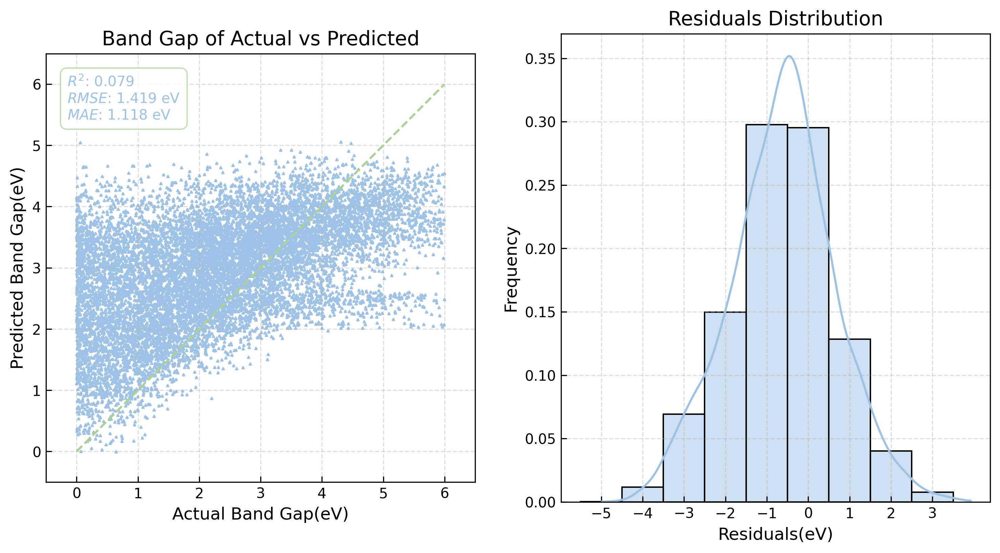


Model Evaluation Results:
Test set: R²: 0.0787 RMSE: 1.4188 MAE: 1.1184
####################################################################################################
[11/11 - EXP - SVR] Training SVR on EXP data:
----------------------------------------------------------------------------------------------------
Starting model training...
[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s
[Pipeline] ............. (step 2 of 2) Processing model, total=   0.4s
Model training completed!
Evaluating EXP SVR on EXP test set:


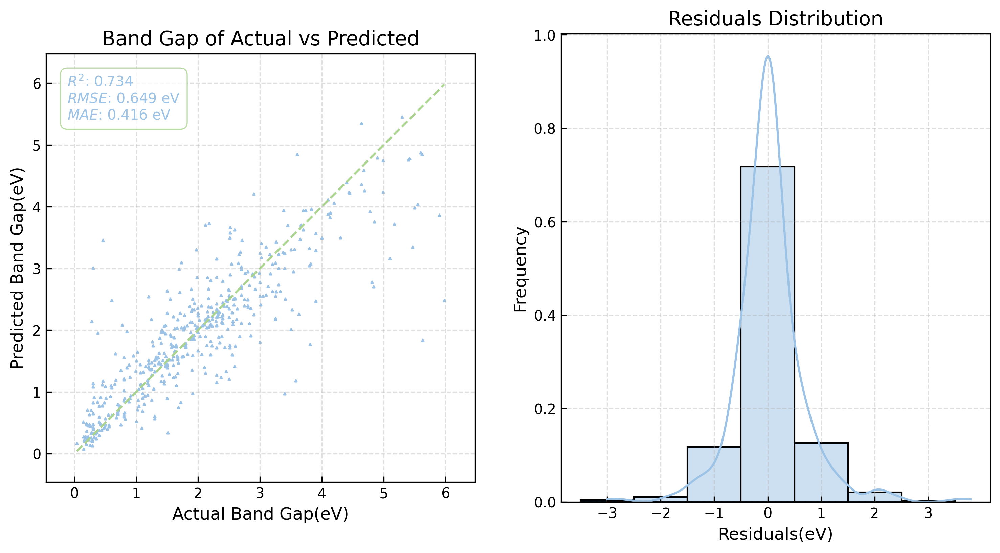


Model Evaluation Results:
Test set: R²: 0.7336 RMSE: 0.6486 MAE: 0.4160
Evaluating EXP SVR on DFT test set:


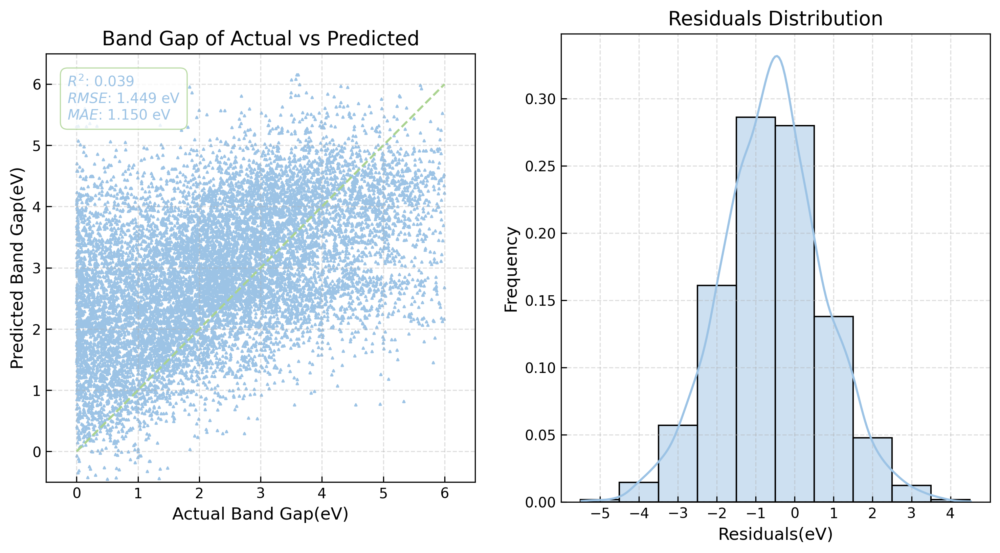


Model Evaluation Results:
Test set: R²: 0.0388 RMSE: 1.4492 MAE: 1.1498


In [12]:
model_number = 0
model_nums = len(exp_models)
# Loop through each model
for model_name, model in exp_models.items():
    model_number += 1
    # Create directories for saving models and figures
    file_path = os.path.join(current_path, model_name)
    fig_path = os.path.join(file_path, 'figures')
    model_path = os.path.join(file_path, 'model')
    # Create directories if they don't exist
    os.makedirs(file_path, exist_ok=True)
    os.makedirs(fig_path, exist_ok=True)
    os.makedirs(model_path, exist_ok=True)
    
    # record model metrics  
    model_metrics = pd.DataFrame(columns=['Model', 'Train_set', 'Test_set', 'R²', 'RMSE', 'MAE'])
    ################################################
    # Train the model on exp data
    print("#" * 100)
    print(f"[{model_number}/{model_nums} - EXP - {model_name}] Training {model_name} on EXP data:")
    print("-" * 100)

    exp_model = SingleModel(clone(model), random_state=RANDOM_SEED)
    exp_model.train(exp_train_X, exp_train_y)
    # evaluate on the exp test set
    print(f"Evaluating EXP {model_name} on EXP test set:")
    metrics = exp_model.evaluate(exp_test_X, exp_test_y, fig_path=os.path.join(fig_path, 'exp_train_exp_test.png'))
    model_metrics.loc[len(model_metrics)] = {
    'Model': model_name,
    'Train_set': 'exp',
    'Test_set': 'exp',
    'R²': metrics['r2'],
    'RMSE': metrics['rmse'],
    'MAE': metrics['mae']
}
    # evaluate on the dft test set
    print(f"Evaluating EXP {model_name} on DFT test set:")
    metrics = exp_model.evaluate(dft_test_X, dft_test_y, fig_path=os.path.join(fig_path, 'exp_train_dft_test.png'))
    model_metrics.loc[len(model_metrics)] = {
    'Model': model_name,
    'Train_set': 'exp',
    'Test_set': 'dft',
    'R²': metrics['r2'],
    'RMSE': metrics['rmse'],
    'MAE': metrics['mae']
}
    # save models
    # exp_model.save_model(os.path.join(model_path, f'exp_{model_name}.pkl'))
    
    # save model metrics
    # model_metrics.to_csv(os.path.join(file_path, f'{model_name}_metrics.csv'), index=False)
    # append model metrics to the main metrics dataframe
    metrics_df = pd.concat([metrics_df, model_metrics], ignore_index=True)
    #################################################
    # Feature importance plot
    # For models that support feature importance
    if model_name in ['LightGBM', 'XGBoost', 'RandomForest', 'ExtraRandomTrees']:
        # 
        print(f"Plotting feature importance for {model_name} on EXP data:")
        exp_importances_df = plot_feature_importance(exp_model.get_model(), exp_train_X.columns, top_n=10,
                            fig_path=os.path.join(fig_path, f'exp_feature_importance.png'))  

## Analysis

In [19]:
metrics_df

,Model,Train_set,Test_set,R²,RMSE,MAE
0,ElasticNet,dft,dft,0.429443,1.116509,0.897839
1,ElasticNet,dft,exp,0.236563,1.098023,0.861543
2,Ridge,dft,dft,0.431792,1.114208,0.894726
3,Ridge,dft,exp,0.224864,1.106404,0.869790
4,Lasso,dft,dft,0.371383,1.171940,0.949722
5,Lasso,dft,exp,0.290194,1.058754,0.815135
6,GBR,dft,dft,0.787756,0.680974,0.445992
7,GBR,dft,exp,0.428864,0.949718,0.762366
8,LightGBM,dft,dft,0.773200,0.703937,0.485094
9,LightGBM,dft,exp,0.400990,0.972617,0.772645


In [21]:
# save the final metrics dataframe
metrics_df.to_csv(os.path.join(current_path, 'model_metrics.csv'), index=False)

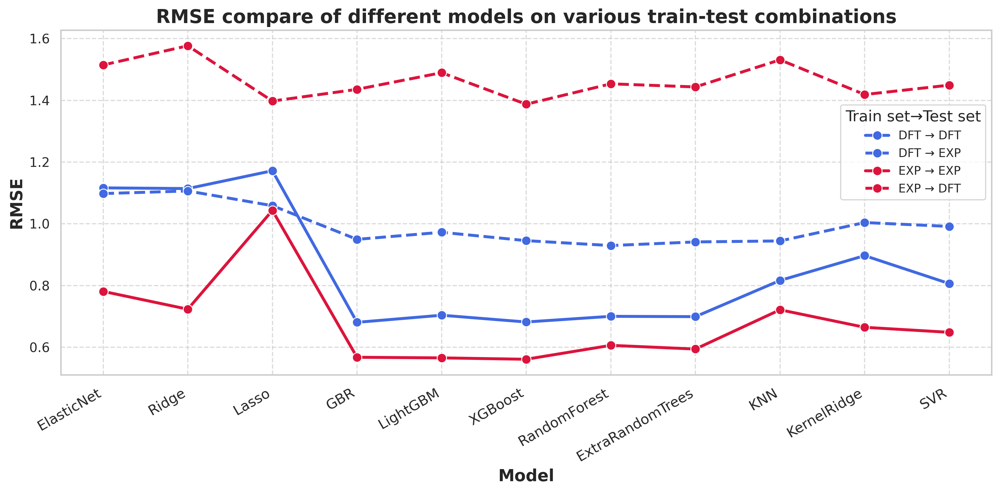

In [20]:
import matplotlib.pyplot as plt
import seaborn as sns

# set style
sns.set_theme(style="whitegrid")
plt.figure(figsize=(12, 6), dpi=300)

# get unique models
models = metrics_df['Model'].unique()

# prepare data for plotting
plot_data = []
for model in models:
    model_metrics = metrics_df[metrics_df['Model'] == model]
    for _, row in model_metrics.iterrows():
        plot_data.append({
            'Model': row['Model'],
            'Training': row['Train_set'],
            'Testing': row['Test_set'],
            'RMSE': row['RMSE']
        })

plot_df = pd.DataFrame(plot_data)

# set line styles for different training-testing combinations
# same dataset training and testing: solid line
# different dataset training and testing: dashed line
# dft training: blue; exp training: red
line_styles = {
    ('dft', 'dft'): {'color': 'royalblue', 'linestyle': '-', 'label': 'DFT → DFT'},
    ('dft', 'exp'): {'color': 'royalblue', 'linestyle': '--', 'label': 'DFT → EXP'},
    ('exp', 'exp'): {'color': 'crimson', 'linestyle': '-', 'label': 'EXP → EXP'},
    ('exp', 'dft'): {'color': 'crimson', 'linestyle': '--', 'label': 'EXP → DFT'}
}

# plot lines for each model
for (train_set, test_set), style in line_styles.items():
    data = plot_df[(plot_df['Training'] == train_set) & (plot_df['Testing'] == test_set)]
    if not data.empty:
        sns.lineplot(
            data=data,
            x='Model',
            y='RMSE',
            marker='o',
            markersize=8,
            linewidth=2.5,
            **style
        )

# beautify the plot
plt.title('RMSE compare of different models on various train-test combinations', fontsize=16, weight='bold')
plt.xlabel('Model', fontsize=14, weight='bold')
plt.ylabel('RMSE', fontsize=14, weight='bold')
plt.xticks(rotation=30, ha='right', fontsize=12)
# set the legend on the right top corner
plt.legend(title='Train set→Test set', loc='upper right', bbox_to_anchor=(1, 0.8), fontsize=10, title_fontsize=13)
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()  # adjust layout to fit all elements

# add figure text
# plt.figtext(0.5, 0.01, 
#            'Solid: train and test on the same type set | Dashes: train and test on the different type set\n'
#            'Blue: train on DFT set | Red: train on EXP set\n', 
#            ha='center', fontsize=11)

# save the figure
plt.savefig(os.path.join(current_path, 'RMSE_comparison.png'), dpi=300, bbox_inches='tight')
plt.show()